### Udacity Self-Driving Car Engineer Nanodegree
# Project 4 &mdash; Advanced Lane Detection
---

## Overview

#### The goals and steps of this project are:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
1. Apply a distortion correction to raw images.
1. Use color transforms, gradients, etc., to create a thresholded binary image.
1. Apply a perspective transform to rectify binary image ("birds-eye view").
1. Detect lane pixels and fit to find the lane boundary.
1. Determine the curvature of the lane and vehicle position with respect to center.
1. Warp the detected lane boundaries back onto the original image.
1. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

---

In [1]:
import cv2
from functools import partial
import glob
from io import BytesIO
from IPython.display import Image
from ipywidgets import interact, interactive, fixed
import matplotlib as mpl
import matplotlib.image as mpimg
import matplotlib.patches as patches
import matplotlib.pyplot as plt
%matplotlib inline
from moviepy.editor import VideoFileClip
from multiprocessing import Pool
import numpy as np
import pickle
from skimage import img_as_ubyte
from tqdm import tqdm

### Helper Functions

In [2]:
# Helper functions for displaying images within the notebook

def show_interactive(img):
    '''Display an image with interactive controls for tuning threshold parameters. 
    
    More info here:
    https://ipython.org/ipython-doc/3/api/generated/IPython.display.html#IPython.display.Image
    '''
    
    if img.ndim == 2:
        format, cmap = 'png', mpl.cm.gray
    elif img.ndim == 3:
        format, cmap = 'jpg', None
    else:
        raise ValueError("Only 2- or 3-d arrays can be displayed as images.")
        
    with BytesIO() as buffer:
        mpl.image.imsave(buffer, img, format=format, cmap=cmap, vmin=0, vmax=1.0)
        out = buffer.getvalue()
        
    return Image(out, width=600)


def show_RGB(img1, img2, title1='Undistorted', title2='Binary', chan1='BGR', chan2='GRAY'):
    '''Displays two images side-by-side using Matplotlib'''
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.set_axis_off(), ax2.set_axis_off()
    
    if chan1 == 'BGR':
        img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    if chan2 == 'BGR':
        img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)    
        
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=20)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=20)

---
## Step 1 | Camera Calibration

In [3]:
# Object point and image point placeholders
nx = 9
ny = 6
objp = np.zeros((ny*nx, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# List of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Locate the chessboard corners
for fname in tqdm(images):
    # Get image array and convert to grayscale
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, add object points, image points
    if ret:
        objpoints.append(objp)
        imgpoints.append(corners)

print('Calibration complete.')

100%|██████████| 20/20 [00:06<00:00,  3.25it/s]

Calibration complete.


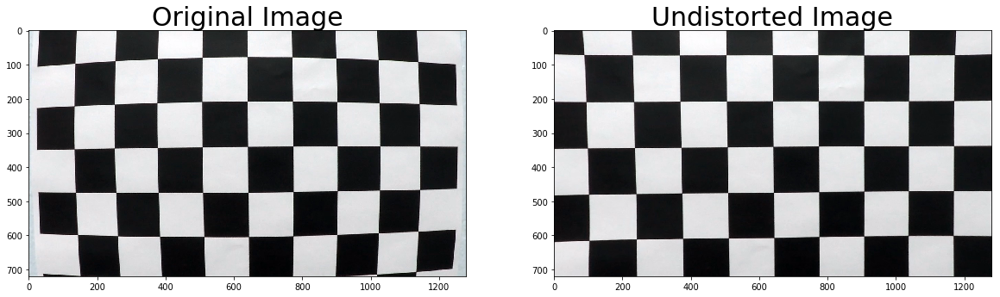

In [4]:
## Test the calibration by undistorting a chessboard image

img_dir = 'camera_cal/'

# Test image
test_img = 'calibration1.jpg'
img = cv2.imread(img_dir + test_img)
img_size = (img.shape[1], img.shape[0])

# Camera calibration 
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# Undistorted version
undist = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite(img_dir + 'test_undist.jpg', undist)

# Save the camera calibration result
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump(dist_pickle, open("camera_cal/calibration1.p", "wb" ) )

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=30)

---
## Step 2 | Distortion Correction

In [5]:
# Undistort function

def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)


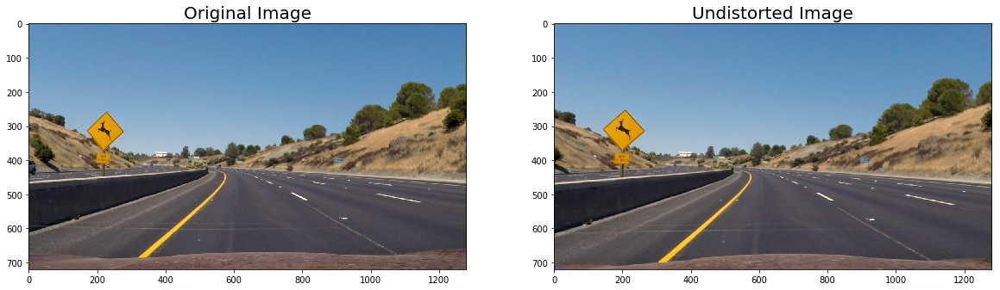

In [6]:
## Apply to driving images

# Original image
orig_img = cv2.imread('test_images/test2.jpg')

# Undistorted version
undist = undistort(orig_img)

# Visualize the images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
ax2.set_title('Undistorted Image', fontsize=20)

#### Observation:
The removal of image distortion is most noticeable if you look at the traffic sign on the left side of the road. You'll notice that it now faces the viewer straight on instead of at an angle. 

### Create Undistorted Versions of Test Images

In [12]:
test1 = undistort(cv2.imread('test_images/test1.jpg'))  # challenging - light pavement
test2 = undistort(cv2.imread('test_images/test2.jpg'))  # optimal conditions
test3 = undistort(cv2.imread('test_images/test3.jpg'))  # optimal conditions
test4 = undistort(cv2.imread('test_images/test4.jpg'))  # challenging - light pavement, shadows
test5 = undistort(cv2.imread('test_images/test5.jpg'))  # challenging - light pavement, shadows
test6 = undistort(cv2.imread('test_images/test6.jpg'))  # challenging - light pavement, shadows

straight1 = undistort(cv2.imread('test_images/straight_lines1.jpg'))  # optimal conditions
straight2 = undistort(cv2.imread('test_images/straight_lines2.jpg'))  # optimal conditions

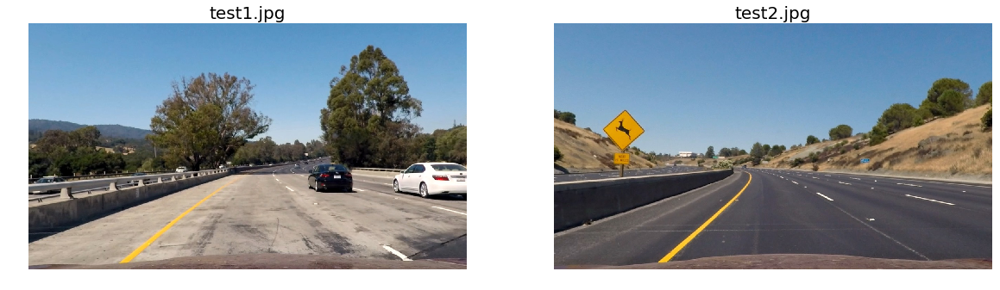

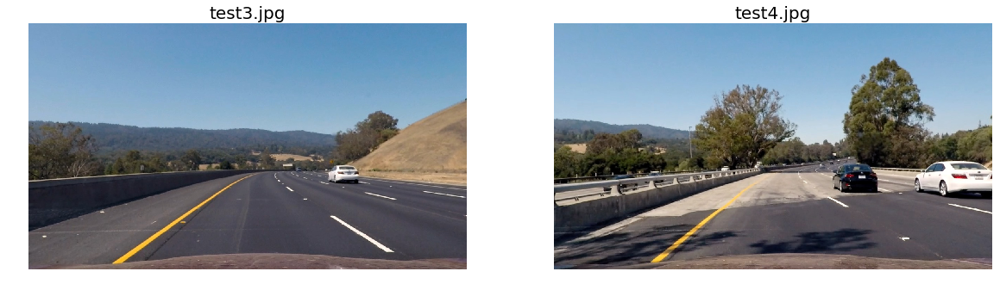

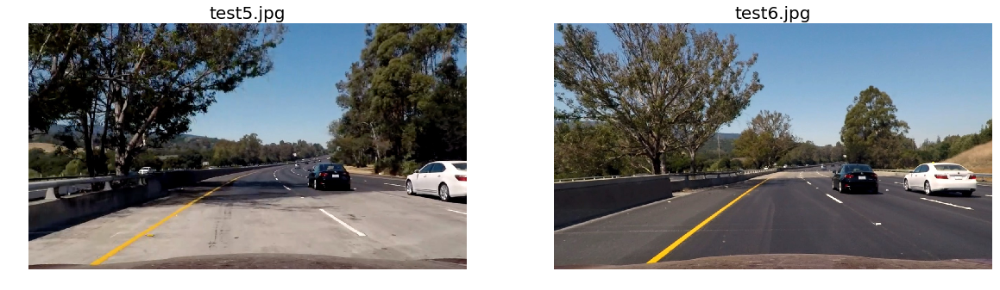

In [9]:
# Visualize the undistorted test images
show_RGB(test1, test2, chan1='BGR', chan2='BGR', title1='test1.jpg', title2='test2.jpg')
show_RGB(test3, test4, chan1='BGR', chan2='BGR', title1='test3.jpg', title2='test4.jpg') 
show_RGB(test5, test6, chan1='BGR', chan2='BGR', title1='test5.jpg', title2='test6.jpg') 

---
## Step 3.1 | Gradient Thresholds

### Directional Gradients for X or Y

In [7]:
# Directional gradient for X or Y using Sobel algorithm

def abs_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Absolulte value of x or y gradient 
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    
    # Rescale to 8-bit integer
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    # Apply threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

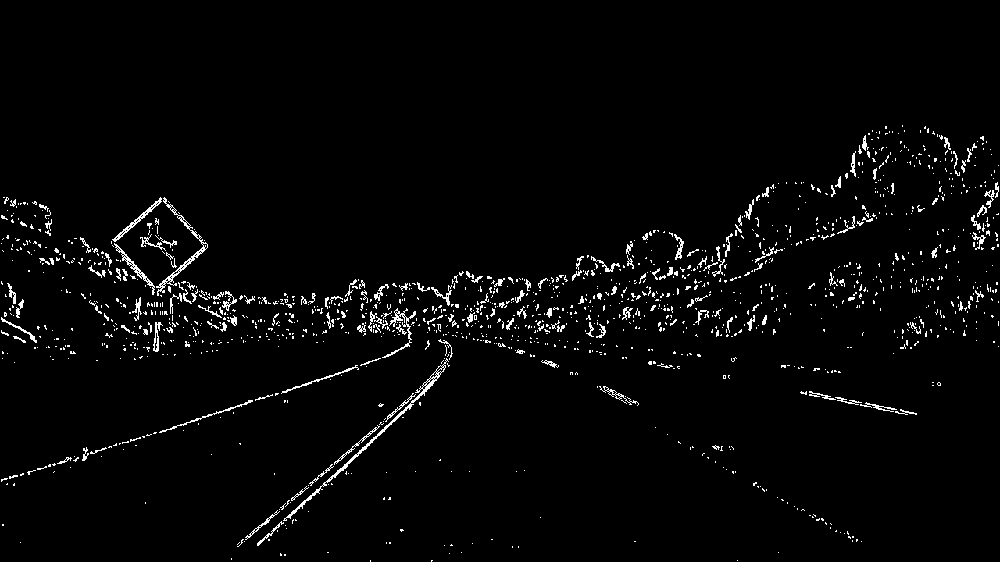

In [37]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)
# More info here -- http://ipywidgets.readthedocs.io/en/stable/examples/Using%20Interact.html

img = test2

@interact
def abs_thresh_image(image: fixed(img), orient:('x','y')='x', sobel_kernel:(3,21,2)=3, 
                     thresh_min:(0,255)=30, thresh_max:(0,255)=100):
  
    binary = abs_thresh(image, orient, sobel_kernel, (thresh_min, thresh_max))
    
    return show_interactive(binary)
    

### Gradient Magnitude

In [94]:
# Gradient magnitude using both X and Y

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):

    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # X and Y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Gradient magnitude
    mag = np.sqrt(sobelx**2 + sobely**2)
    
    # Rescale to 8-bit integer
    scaled_sobel = np.uint8(255 * mag / np.max(mag))
    
    # Apply threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the binary image
    return binary_output

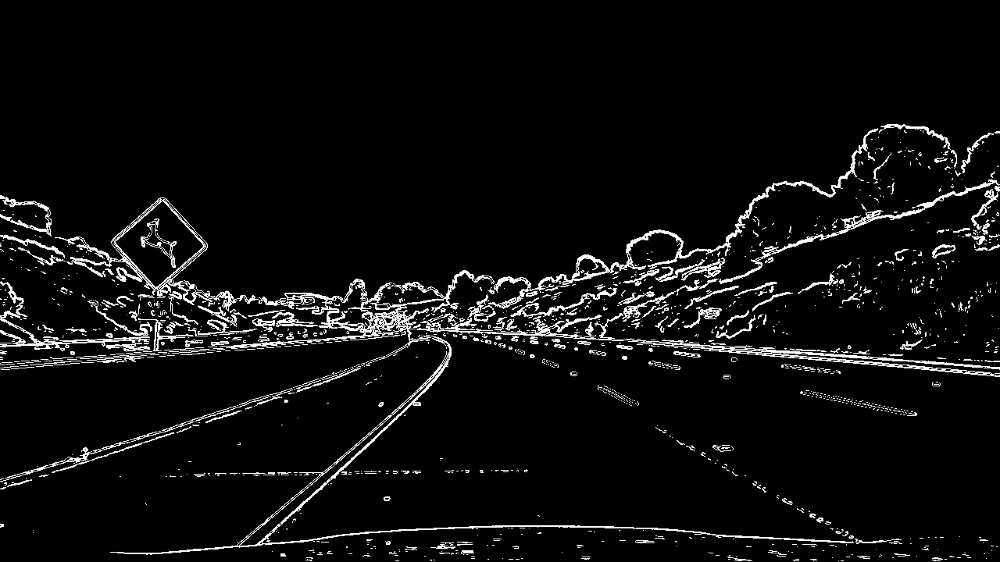

In [95]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

img = test2

@interact
def mag_thresh_image(image: fixed(img), sobel_kernel:(3,21,2)=3, thresh_min:(0,255)=30, thresh_max:(0,255)=100):
  
    mag_binary = mag_thresh(image, sobel_kernel, (thresh_min, thresh_max))
    
    return show_interactive(mag_binary)
    

### Gradient Direction

In [9]:
# Calculate the gradient direction

def dir_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # Calculate the direction of the gradient 
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    
    # Create a binary mask 
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    
    # Return mask as binary output image
    return binary_output

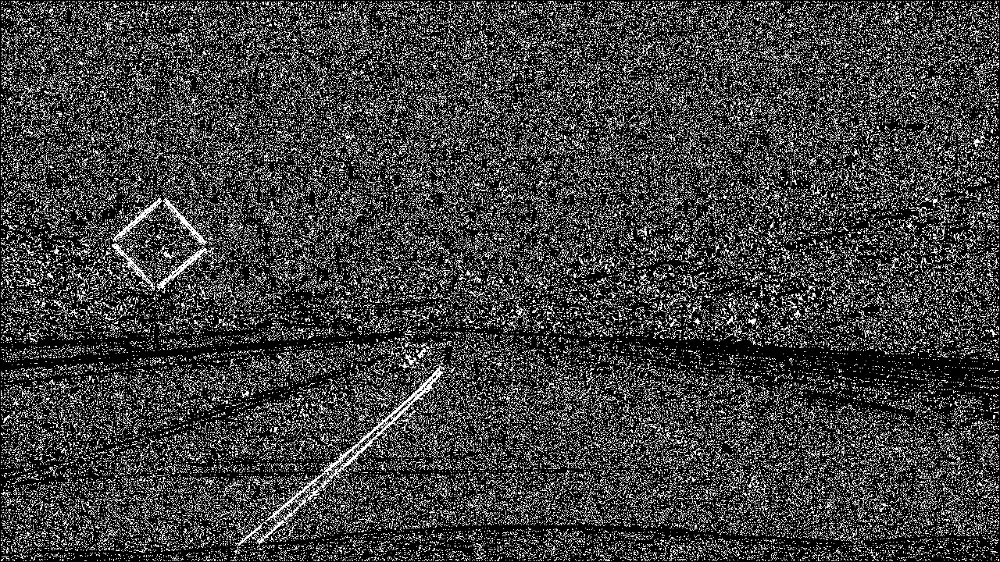

In [39]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

img = test2

@interact
def dir_thresh_image(image:fixed(img), sobel_kernel:(3,21,2)=3, 
                     dir_min:(0.,np.pi/2,0.05)=0.6, dir_max:(0,np.pi/2,0.05)=1.0):
  
    dir_binary = dir_thresh(image, sobel_kernel, thresh=(dir_min, dir_max))
    
    return show_interactive(dir_binary)
    

### Display all directional gradients side by side

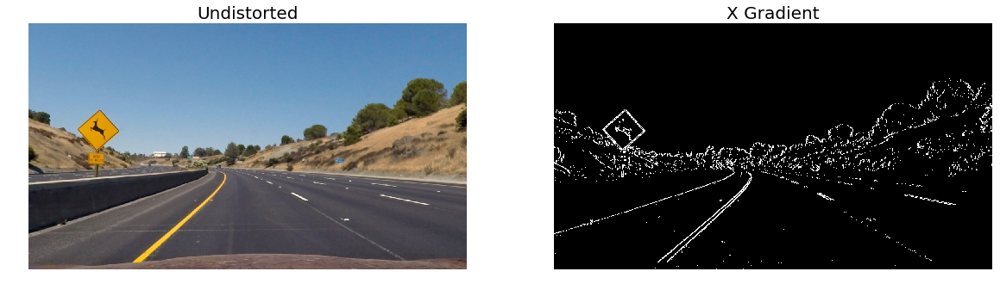

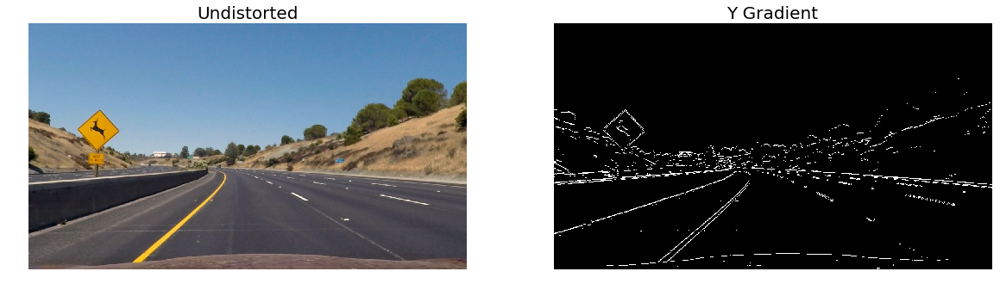

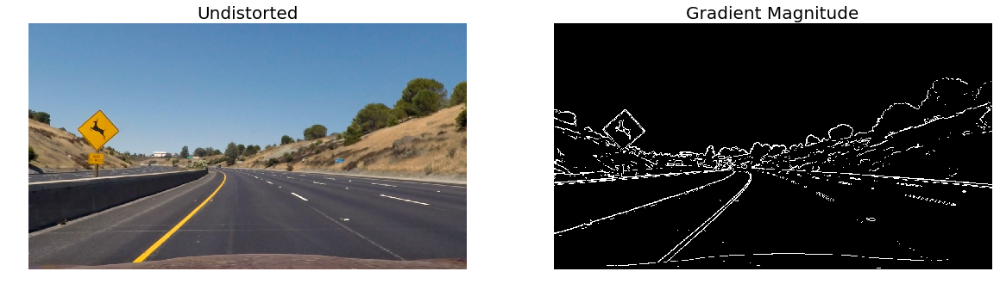

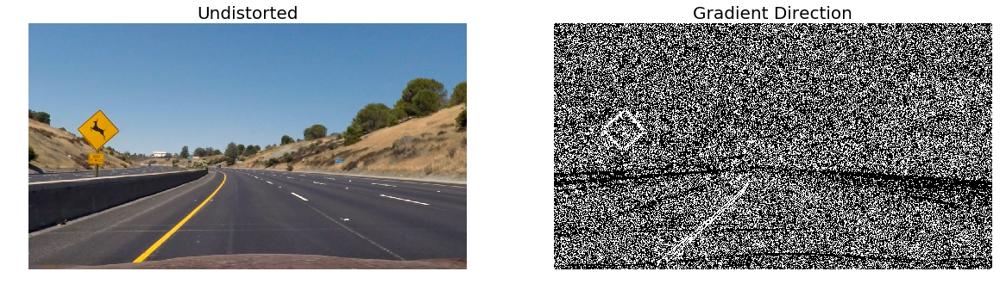

In [13]:
## Display binary outputs next to the undistorted originals

img = test2

# X gradient
sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
show_RGB(undist, sx_binary, title2='X Gradient') 

# Y gradient
sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
show_RGB(undist, sy_binary, title2='Y Gradient') 

# Magnitude
mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
show_RGB(undist, mag_binary, title2='Gradient Magnitude')

# Gradient direction
dir_binary = dir_thresh(img, sobel_kernel=3, thresh=(0.4, 1.1))
show_RGB(undist, dir_binary, title2='Gradient Direction') 

### Combine the Most Useful Thresholds
In this case, we take the union of the X gradient, Y gradient, and their magnitude.

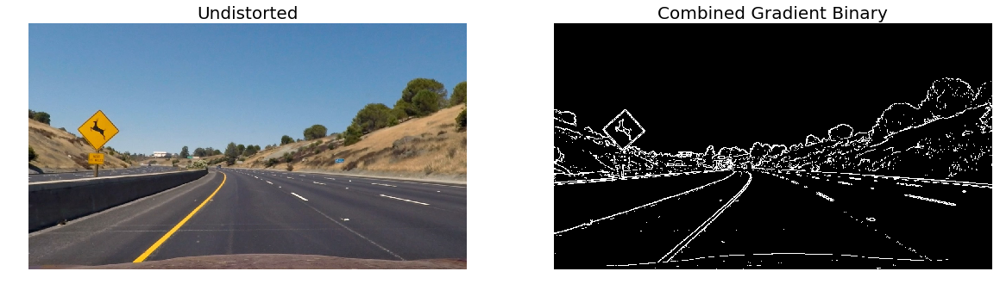

In [14]:
comb_grad_binary = np.zeros_like(sx_binary)
comb_grad_binary[((sx_binary == 1) | (sy_binary == 1)) | (mag_binary == 1)] = 1
show_RGB(test2, comb_grad_binary, title2='Combined Gradient Binary') 

---
## Step 3.2 | Color Thresholds
In this section we explore different thresholds by isolating specific color channels within the image.

&nbsp;
### Grayscale

In [25]:
def gray_thresh(img, thresh=(0, 255)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Create binary mask based on thresholds
    gray_binary = np.zeros_like(gray)
    gray_binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    
    return gray_binary

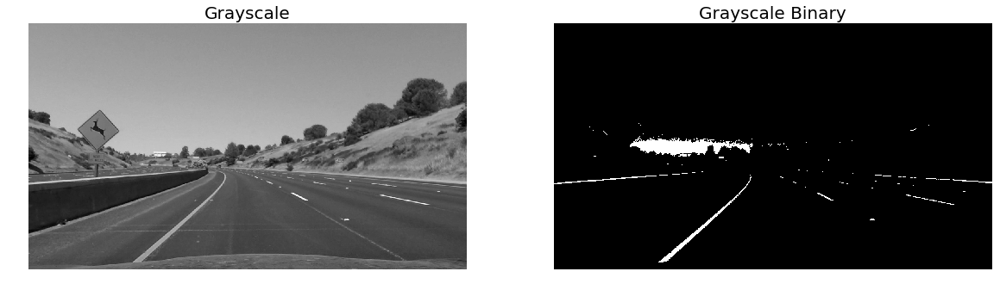

In [26]:
img = test2
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray_binary = gray_thresh(img, thresh=(182, 255))
show_RGB(gray, gray_binary, chan1='gray', title1='Grayscale', title2='Grayscale Binary') 

&nbsp;
### Contrast Limited Adaptive Histogram Equalization (CLAHE)
I had some success using this approach in [Project 2: Identifying Traffic Signs](https://github.com/tommytracey/udacity/tree/master/self-driving-nano/projects/2-traffic-signs#data-preprocessing). So, I'm experimenting with it again here on this project, although this time I'm using the [OpenCV method](http://docs.opencv.org/3.1.0/d6/dc7/group__imgproc__hist.html#ga7e54091f0c937d49bf84152a16f76d6e) instead of the [Scikit method](http://scikit-image.org/docs/dev/api/skimage.exposure.html#skimage.exposure.equalize_adapthist). I'm also customizing the approach by applying smoothing just prior to the CLAHE. This seemed to be an effective strategy for removing noise in both project 1 and project 3. 

More information explaning this method is available [here in the OpenCV docs](http://docs.opencv.org/3.1.0/d5/daf/tutorial_py_histogram_equalization.html).

In [92]:
# CLAHE threshold function

def clahe_thresh(img, thresh=182):
    '''Applies the Contrast Limited Adaptive Histogram Equalization (CLAHE) algorithm.  
    '''
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.uint8)
    
    # Apply smoothing
    img = cv2.medianBlur(img, 3)
    
    # Apply CLAHE
    img = cv2.equalizeHist(img)
    
    # Apply threshold and create binary
    ret, clahe_binary = cv2.threshold(img, thresh=thresh, maxval=255, type=cv2.THRESH_BINARY)

    return clahe_binary

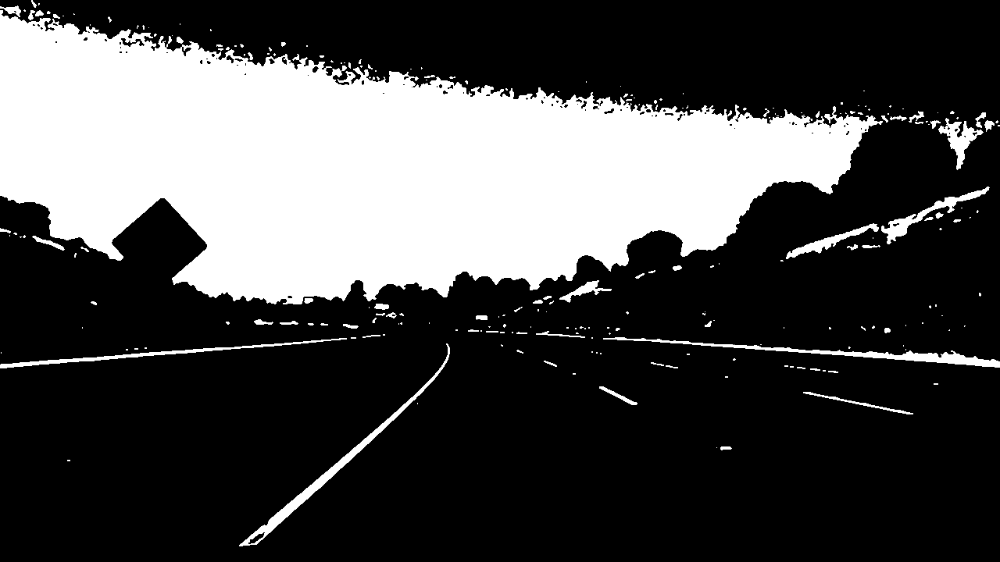

In [93]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

img = test2

@interact
def clahe_thresh_image(image: fixed(undist), thresh:(0,255)=182):
  
    clahe_binary = clahe_thresh(image, thresh)
    
    return show_interactive(clahe_binary)
    

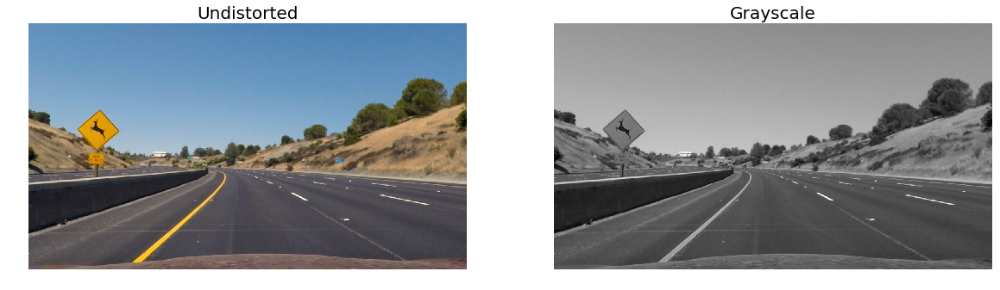

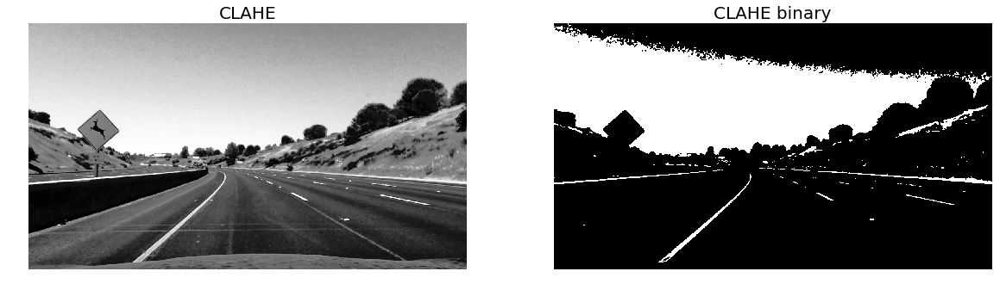

In [42]:
# Show CLAHE and its binary mask side-by-side

img = test2

gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(img, thresh=182)

show_RGB(img, gray, title2='Grayscale')
show_RGB(clahe, clahe_binary, chan1='gray', title1='CLAHE', title2='CLAHE binary') 

#### CONCLUSION:
Again the CLAHE has proven effective. It's a noticeable improvement over using grayscale alone. We'll see how it compares with other approaches in the following section, but the lane detection is very good and it seems like CLAHE could be part of the final thresholding solution. But first we need to test it and other approaches on a more challenging set of images.

&nbsp;
### More Challenging Test Images
So far, the methods above appear effective at identifying lane lines under fairly optimal driving conditions (i.e. clear lane markings, no shadows, no glare, consistent pavement color, etc). Now let's see how well these methods perform on a more challenging set of test images. 

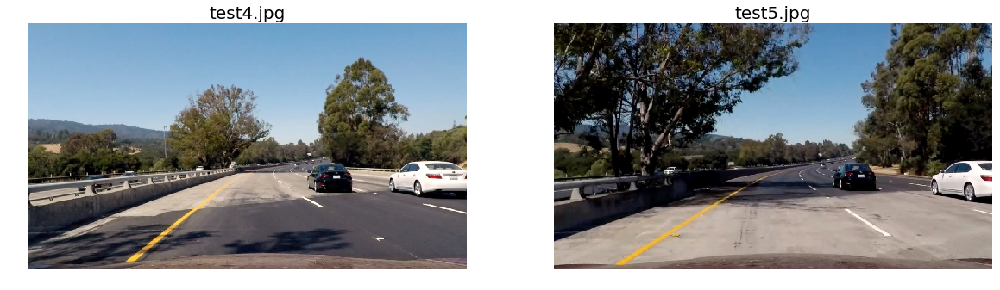

In [43]:
show_RGB(test4, test5, chan1='BGR', chan2='BGR', title1='test4.jpg', title2='test5.jpg')

#### Results for test4.jpg

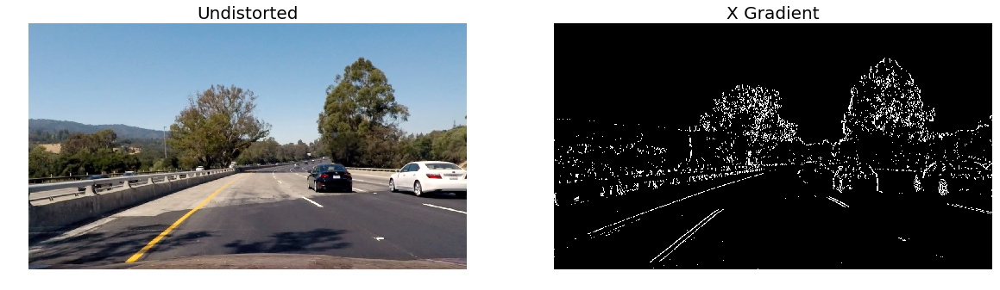

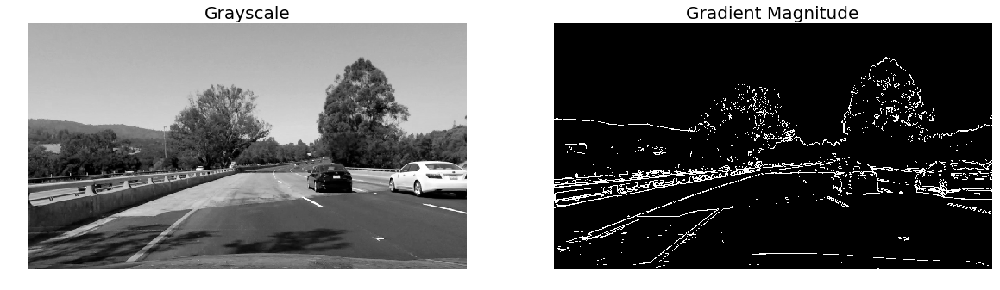

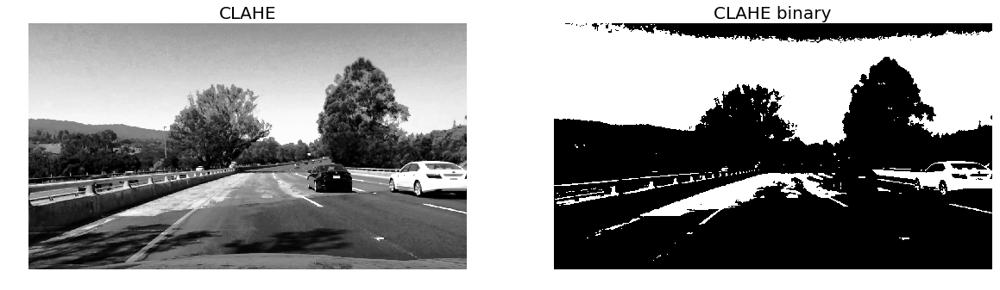

In [16]:
## Display binary outputs next to the undistorted originals

img = test4

# X gradient
sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))

# Magnitude
mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))

# CLAHE
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(img, thresh=160)

# Visualize results
show_RGB(img, sx_binary, chan2='gray', title2='X Gradient')
show_RGB(gray, mag_binary, chan1='gray', chan2='gray', title1='Grayscale', title2='Gradient Magnitude')
show_RGB(clahe, clahe_binary, chan1='gray', chan2='gray', title1='CLAHE', title2='CLAHE binary') 


#### Results for test5.jpg

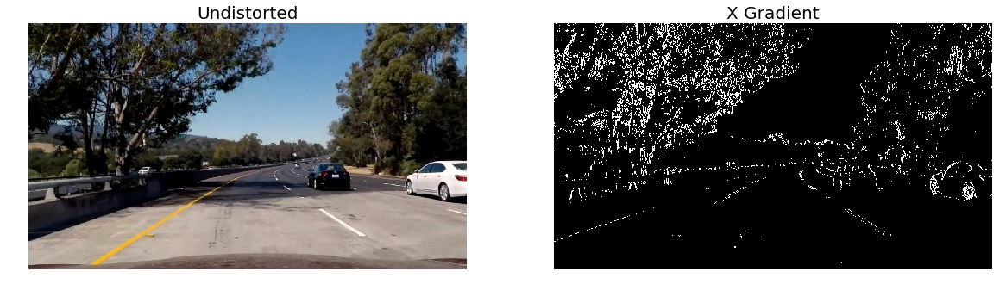

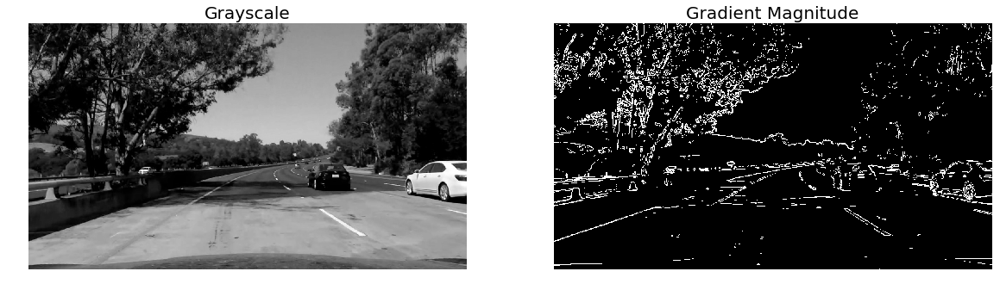

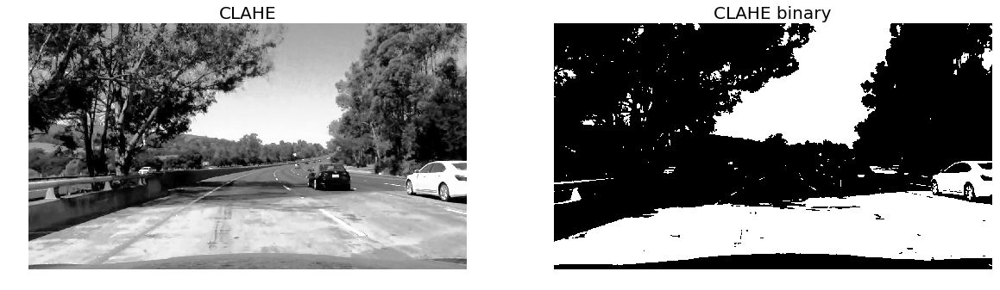

In [45]:
## Display binary outputs next to the undistorted originals

img = test5

# X gradient
sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))

# Magnitude
mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))

# CLAHE
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(img, thresh=160)

# Visualize results
show_RGB(img, sx_binary, chan2='gray', title2='X Gradient')
show_RGB(gray, mag_binary, chan1='gray', chan2='gray', title1='Grayscale', title2='Gradient Magnitude')
show_RGB(clahe, clahe_binary, chan1='gray', chan2='gray', title1='CLAHE', title2='CLAHE binary') 


#### CONCLUSION:
Clearly the thresholding methods that worked on the optimal stretches of road will NOT work across all types of driving conditions. The lane lines are almost completely undetectable in the more challenging test images. So, we need to keep experimenting, while using the challenge images as our testing baseline. 

&nbsp;
### Red, Green, Blue (RGB) Color Channels

In [17]:
def rgb_thresh(img, channel='R', thresh=(200, 255)):
    
    # Split the image into its color channels
    R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]
    
    # Select the channel to use
    if channel == 'R':
        channel = R
    elif channel == 'G':
        channel = G
    elif channel == 'B':
        channel = B
    else:
        raise ValueError("Channel not recognized. Only RGB channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    rgb_binary = np.zeros_like(channel)
    rgb_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return rgb_binary

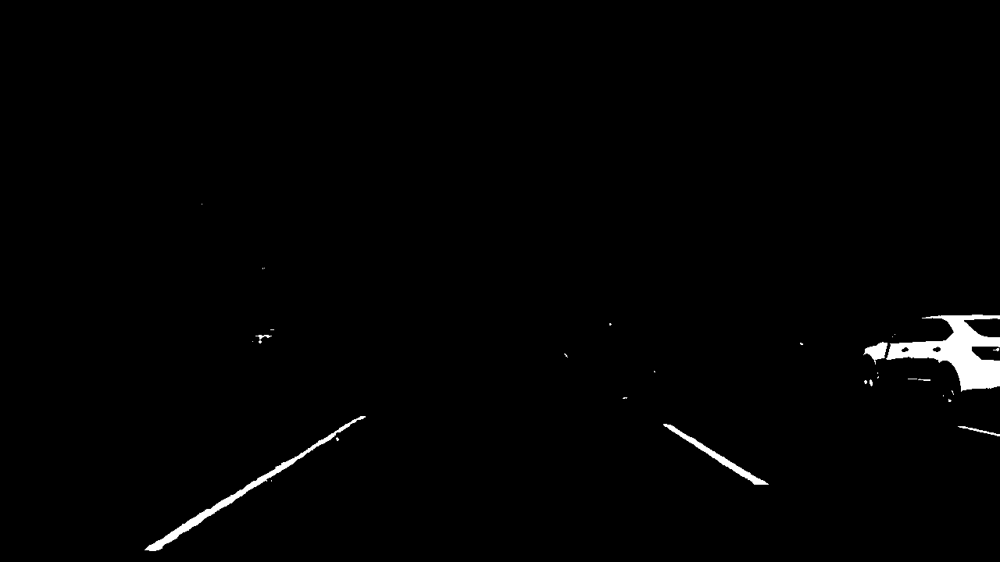

In [36]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test5

@interact
def rgb_thresh_image(image: fixed(img), channel:('R','G','B')='R', thresh_min:(0,255)=225, thresh_max:(0,255)=255):
  
    rgb_binary = rgb_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(rgb_binary)
    

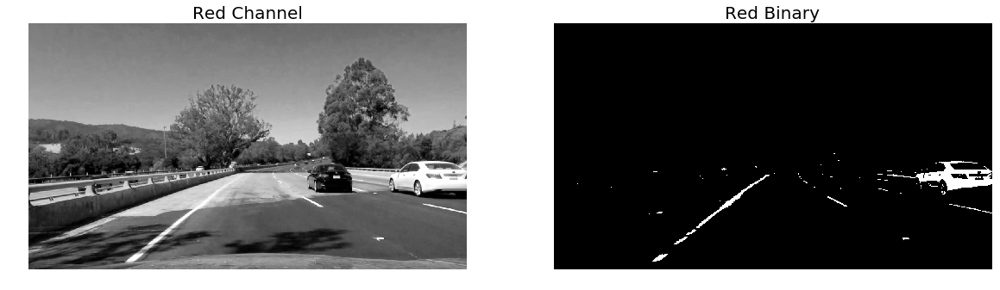

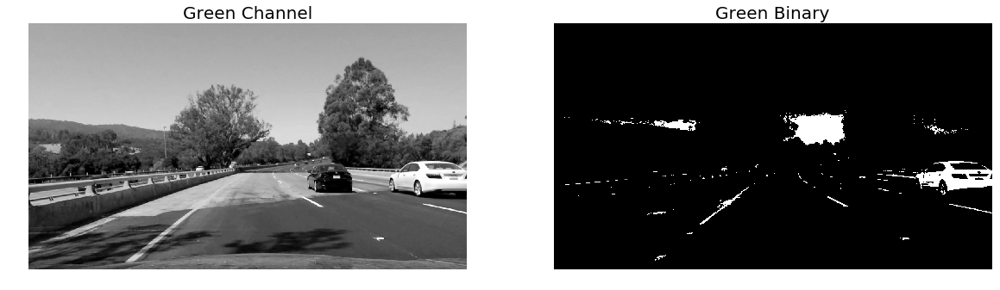

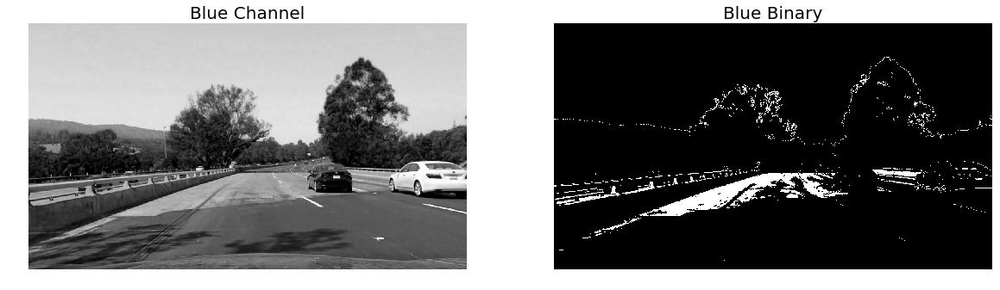

In [18]:
## Show channels and binaries side-by-side

img = test4

# Manually extract RGB channels for display comparison with binaries
R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]  # note the channel order is flipped from cv2.imread's BGR output

# Create binaries
r_binary = rgb_thresh(img, channel='R', thresh=(225,255))
g_binary = rgb_thresh(img, channel='G', thresh=(205,255))
b_binary = rgb_thresh(img, channel='B', thresh=(160,187))

# Visualize results
show_RGB(R, r_binary, chan1='gray', chan2='gray', title1='Red Channel', title2='Red Binary')
show_RGB(G, g_binary, chan1='gray', chan2='gray', title1='Green Channel', title2='Green Binary')
show_RGB(B, b_binary, chan1='gray', chan2='gray', title1='Blue Channel', title2='Blue Binary')

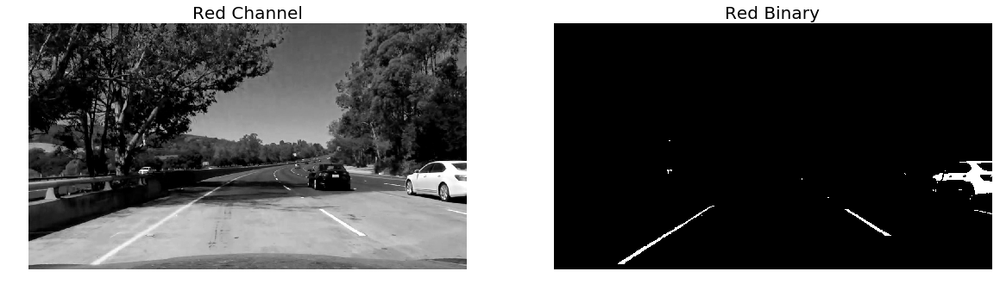

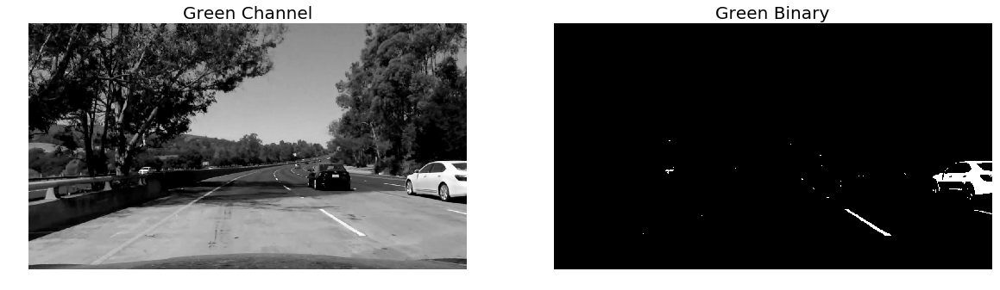

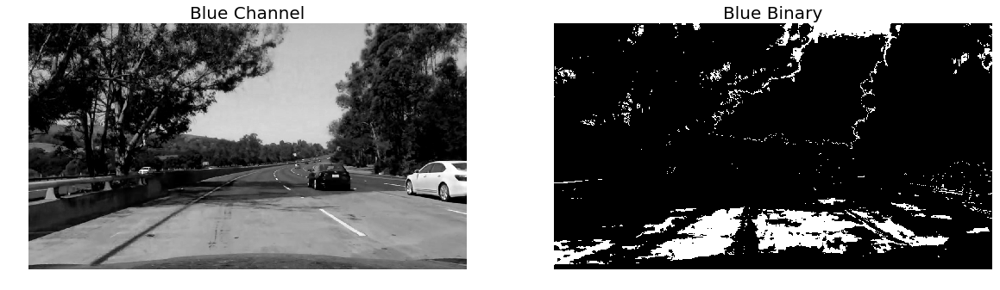

In [47]:
## Show channels and binaries side-by-side

img = test5

# Manually extract RGB channels for display comparison with binaries
R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]  # note the channel order is flipped from cv2.imread's BGR output

# Create binaries
r_binary = rgb_thresh(img, channel='R', thresh=(225,255))
g_binary = rgb_thresh(img, channel='G', thresh=(205,255))
b_binary = rgb_thresh(img, channel='B', thresh=(160,187))

# Visualize results
show_RGB(R, r_binary, chan1='gray', chan2='gray', title1='Red Channel', title2='Red Binary')
show_RGB(G, g_binary, chan1='gray', chan2='gray', title1='Green Channel', title2='Green Binary')
show_RGB(B, b_binary, chan1='gray', chan2='gray', title1='Blue Channel', title2='Blue Binary')

#### CONCLUSION:
The red color channel might prove useful, but most likely the green and blue channels will not. 

#### &nbsp;
### HLS (Hue, Lightness, Saturation) Color Channels

In [19]:
def hls_thresh(img, channel='S', thresh=(200, 255)):
    
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    
    # Split the image into its color channels
    H, L, S = hls[:,:,0], hls[:,:,1], hls[:,:,2]
    
    # Select the channel to use
    if channel == 'H':
        channel = H
    elif channel == 'L':
        channel = L
    elif channel == 'S':
        channel = S
    else:
        raise ValueError("Channel not recognized. Only HLS channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    hls_binary = np.zeros_like(channel)
    hls_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return hls_binary

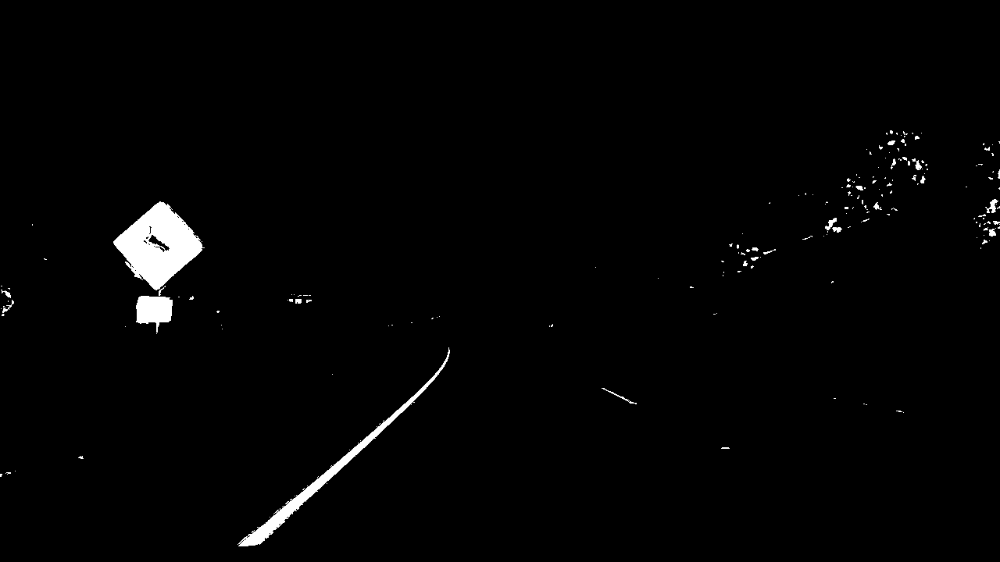

In [49]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test2

@interact
def hls_thresh_image(image: fixed(img), channel:('H','L','S')='S', thresh_min:(0,255)=150, thresh_max:(0,255)=255):
  
    hls_binary = hls_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(hls_binary)
    

#### Test HLS on simple image

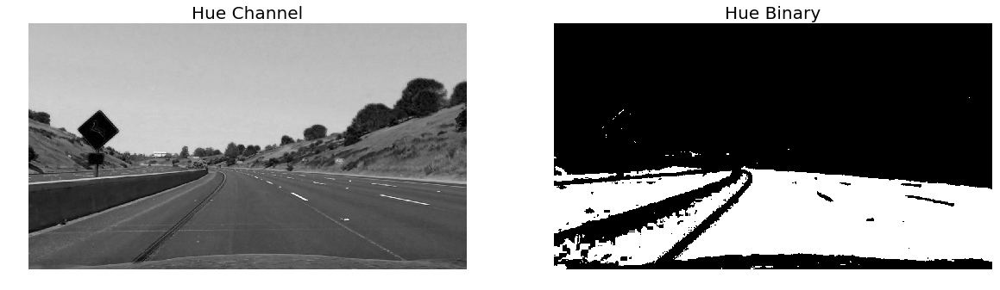

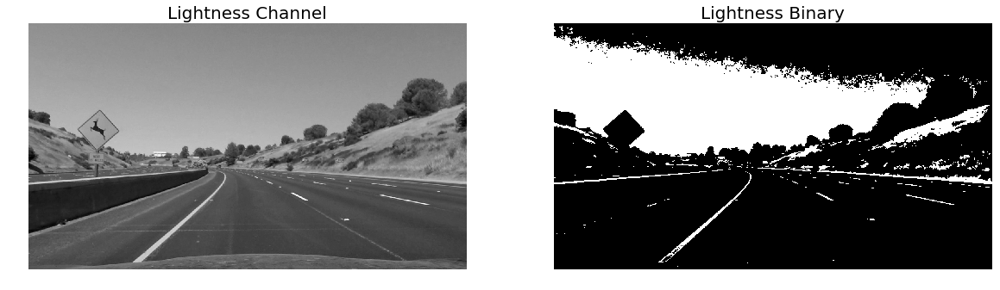

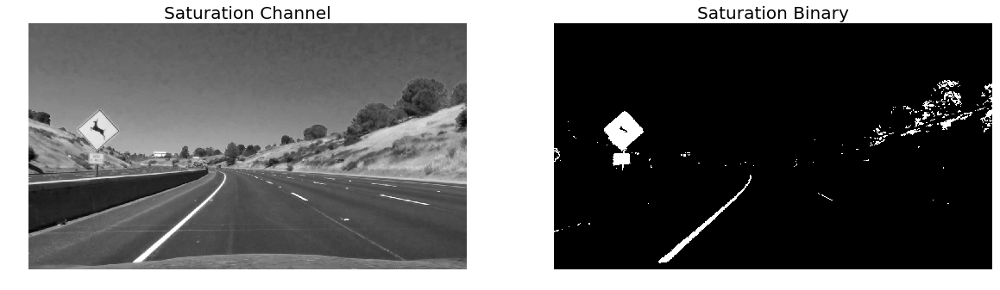

In [50]:
## Show channels and binaries side-by-side

img = test2

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

#### Test HLS on challenge images

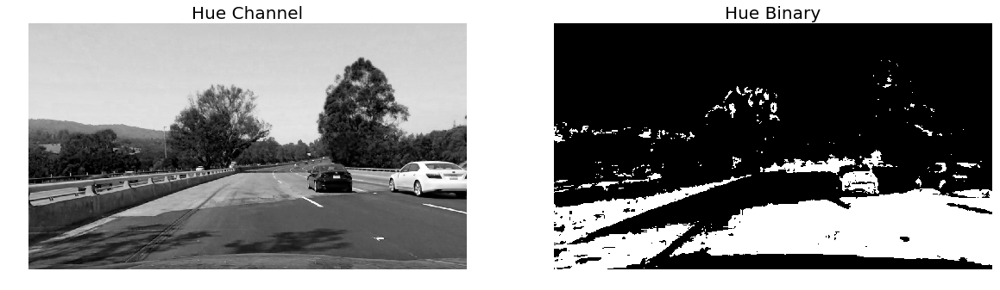

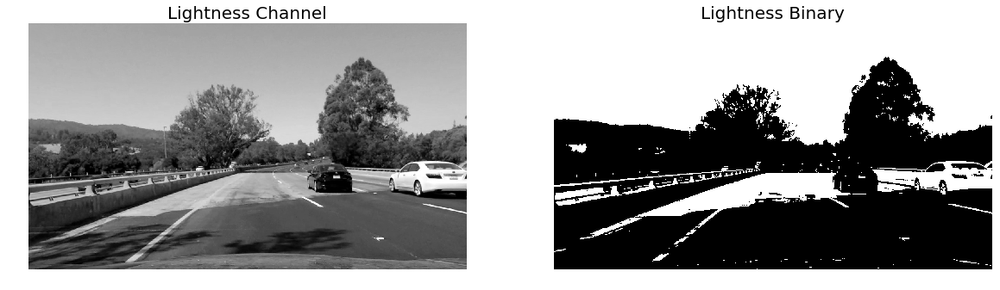

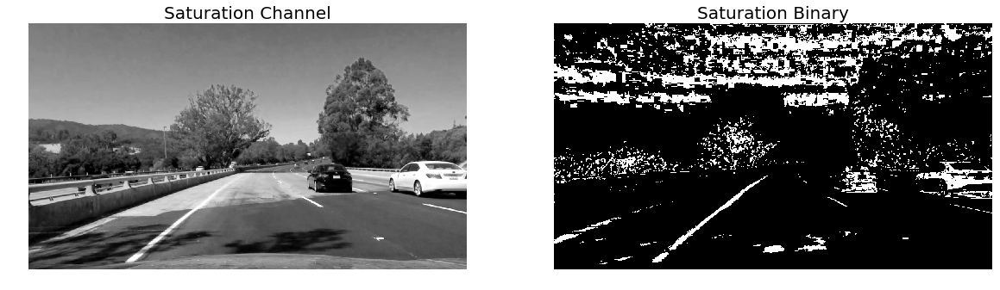

In [51]:
## Show channels and binaries side-by-side

img = test4

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

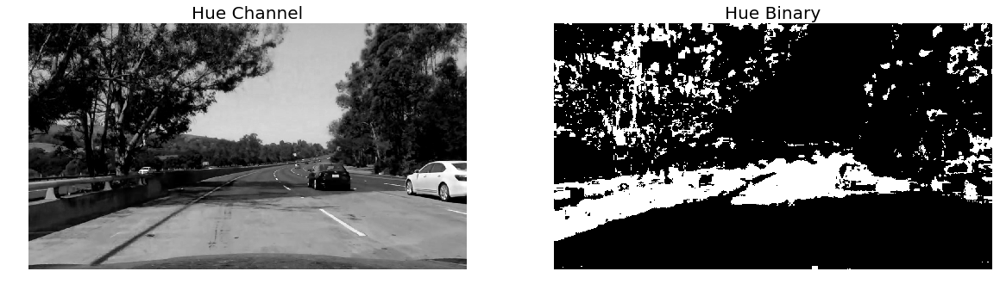

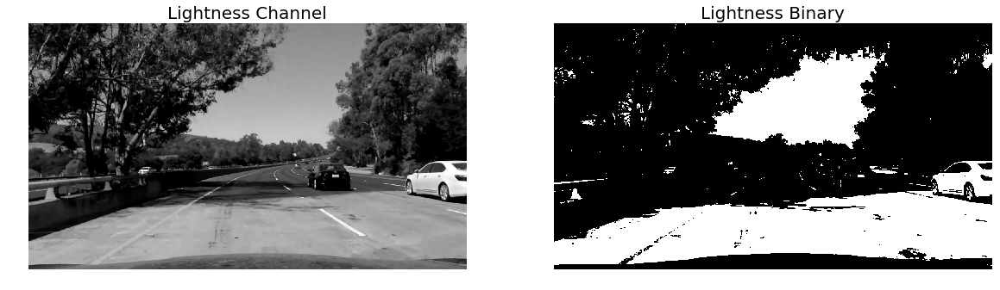

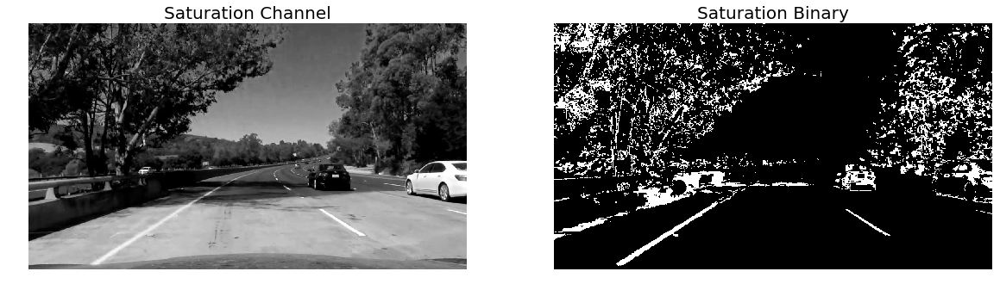

In [52]:
## Show channels and binaries side-by-side

img = test5

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

#### CONCLUSION:
While all three of the HLS channels seem to work to varying degrees on the simple image, only the saturation channel (S) is versatile enough to work on both simple and challenging images. Although the S channel still seems to struggle with shadows, overall it's the best filter so far and is probably worth using as part of the final solution.

#### &nbsp;
### HSV (Hue, Saturation, Value) Color Channels

In [20]:
def hsv_thresh(img, channel='S', thresh=(200, 255)):
    
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Split the image into its color channels
    H, S, V = hsv[:,:,0], hsv[:,:,1], hsv[:,:,2]
    
    # Select the channel to use
    if channel == 'H':
        channel = H
    elif channel == 'S':
        channel = S
    elif channel == 'V':
        channel = V
    else:
        raise ValueError("Channel not recognized. Only HSV channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    hsv_binary = np.zeros_like(channel)
    hsv_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return hsv_binary

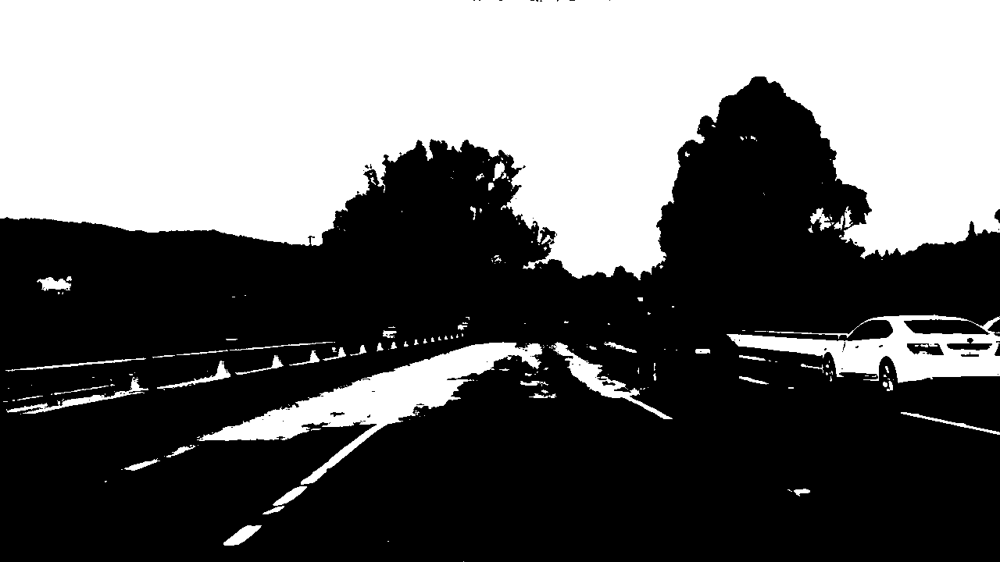

In [54]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test4

@interact
def hsv_thresh_image(image: fixed(img), channel:('H','S','V')='V', thresh_min:(0,255)=196, thresh_max:(0,255)=255):
  
    hsv_binary = hsv_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(hsv_binary)
    

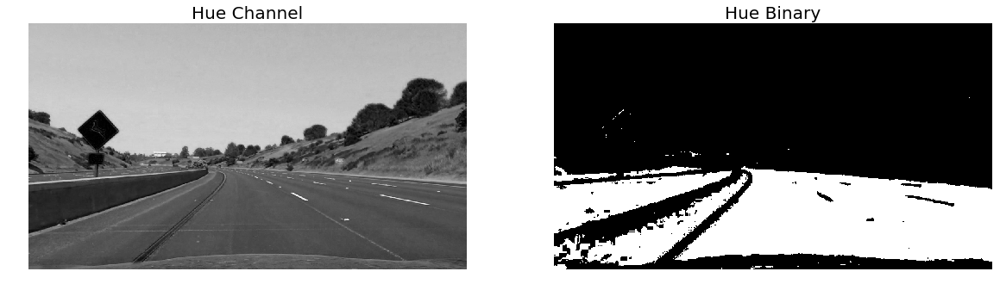

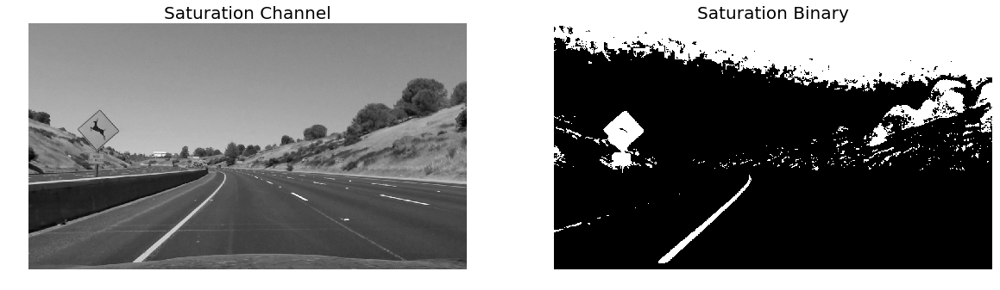

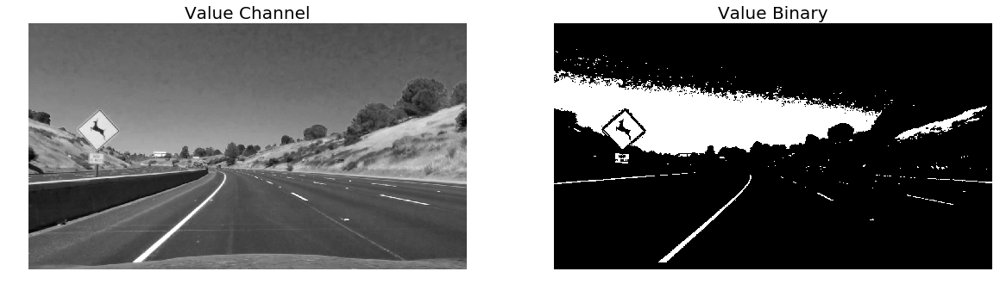

In [55]:
## Show channels and binaries side-by-side

img = test2

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(196,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

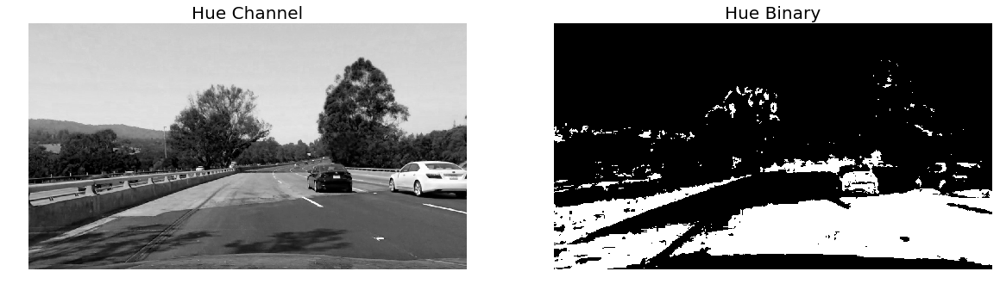

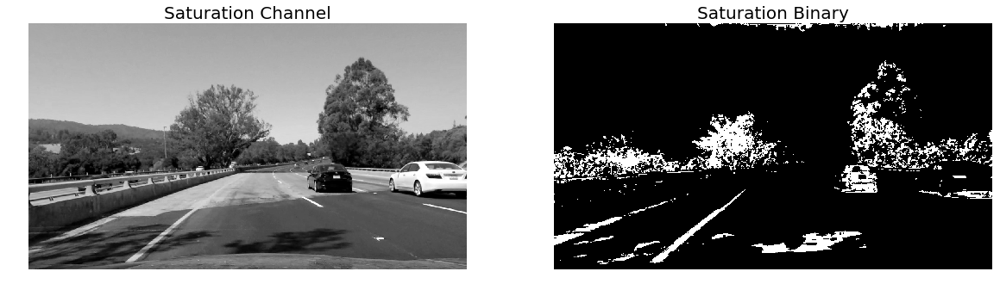

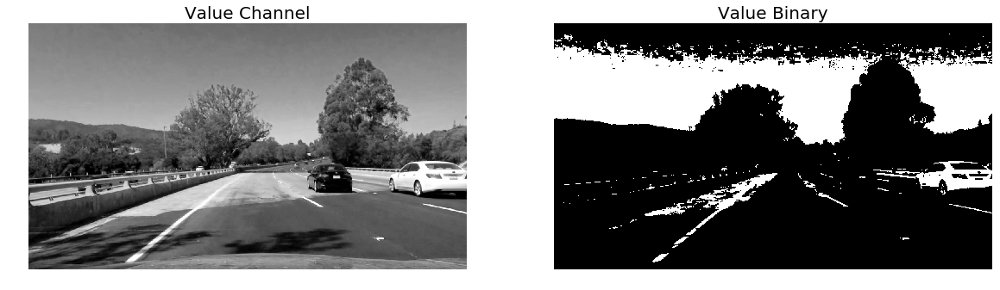

In [56]:
## Show channels and binaries side-by-side

img = test4

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(209,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

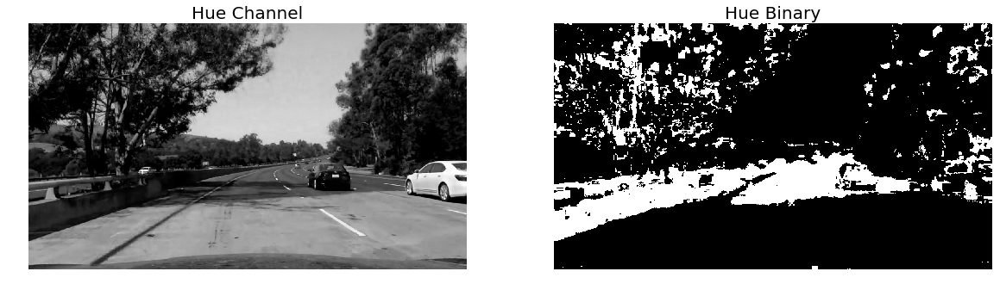

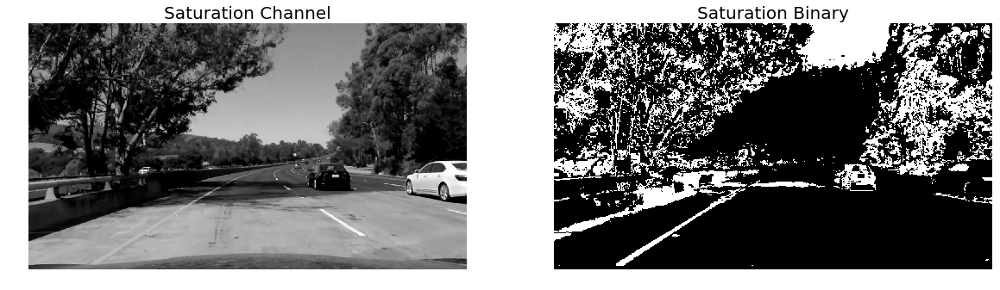

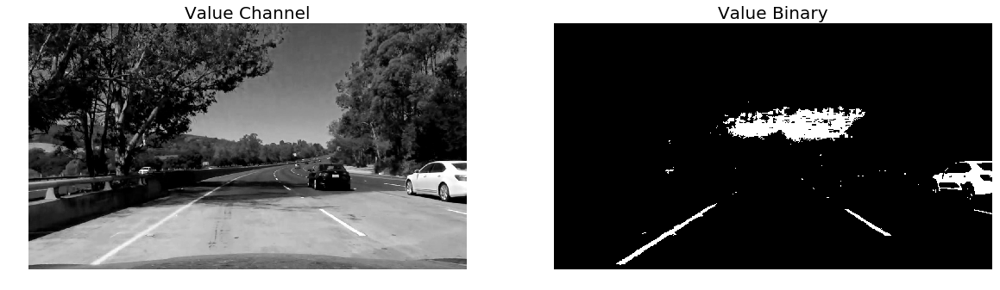

In [57]:
## Show channels and binaries side-by-side

img = test5

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(209,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

#### CONCLUSION:
It appears the value (V) channel in the HSV color space does a really nice job of identifying lane lines under optimal driving conditions. It actually does a better job identifying the inside white lanes than the saturation (S) channel. However, the V channel does not perform as well as the S channel when confronted with shadows or low contrast pavement. Therefore, it seems that the S and V channels compliment each other and are likey to be part of the final solution.

#### &nbsp;
### YUV (luma and chrominance) Color Channels

In [21]:
def yuv_thresh(img, channel='Y', thresh=(150, 255)):
    
    # Convert to YUV
    yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    
    # Split the image into its color channels
    Y, U, V = yuv[:,:,0], yuv[:,:,1], yuv[:,:,2]
    
    # Select the channel to use
    if channel == 'Y':
        channel = Y
    elif channel == 'U':
        channel = U
    elif channel == 'V':
        channel = V
    else:
        raise ValueError("Channel not recognized. Only YUV channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    yuv_binary = np.zeros_like(channel)
    yuv_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return yuv_binary

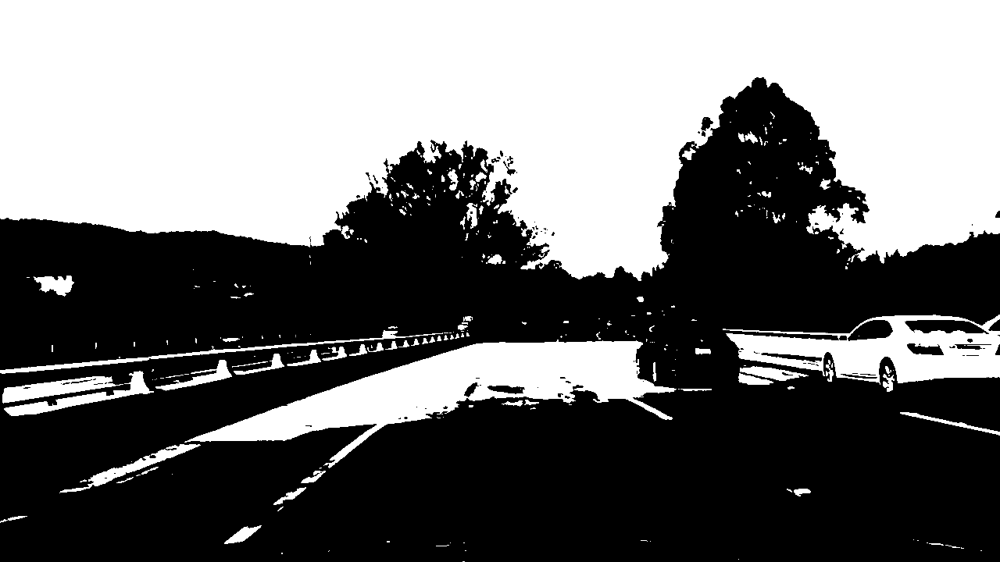

In [22]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test4

@interact
def yuv_thresh_image(image: fixed(img), channel:('Y','U','V')='Y', thresh_min:(0,255)=150, thresh_max:(0,255)=255):
  
    yuv_binary = yuv_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(yuv_binary)
    

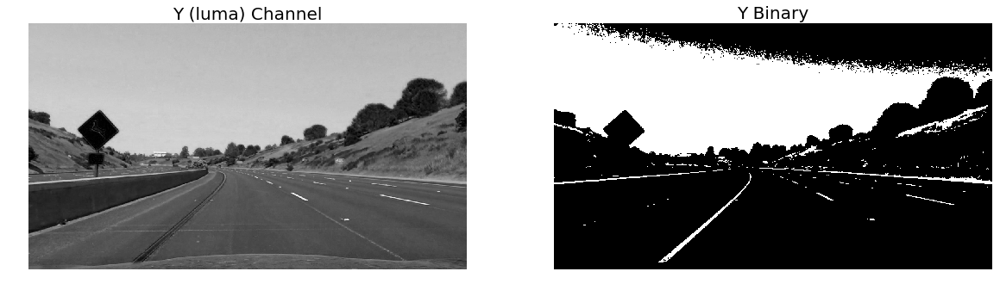

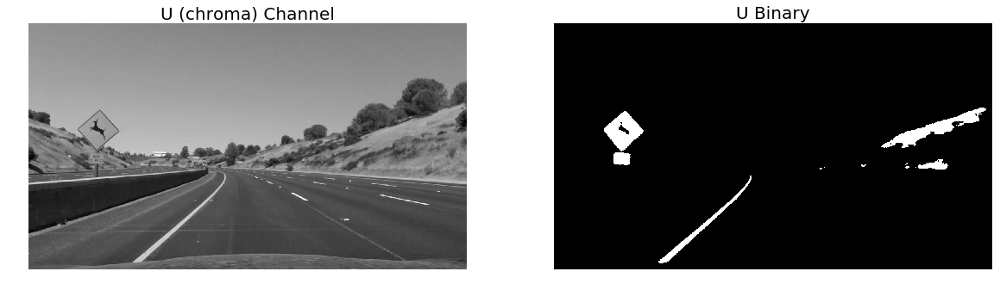

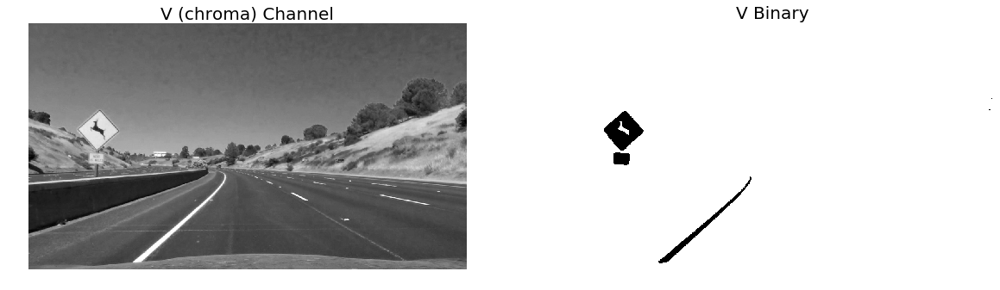

In [23]:
## Vhow channels and binaries side-by-side

img = test2

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(150,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

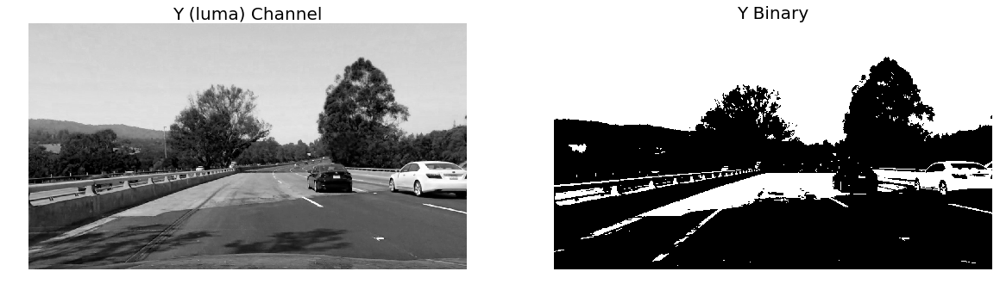

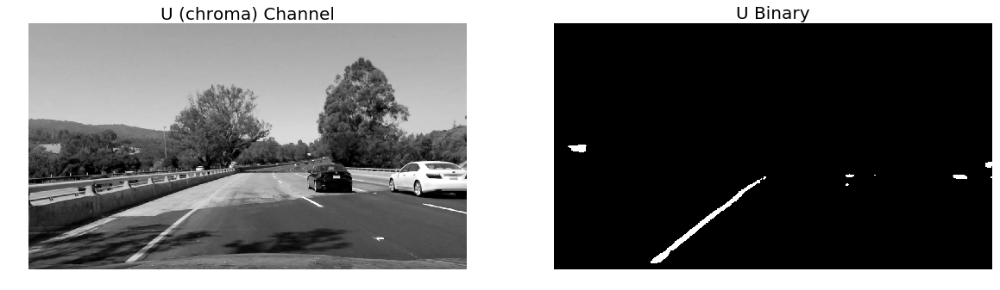

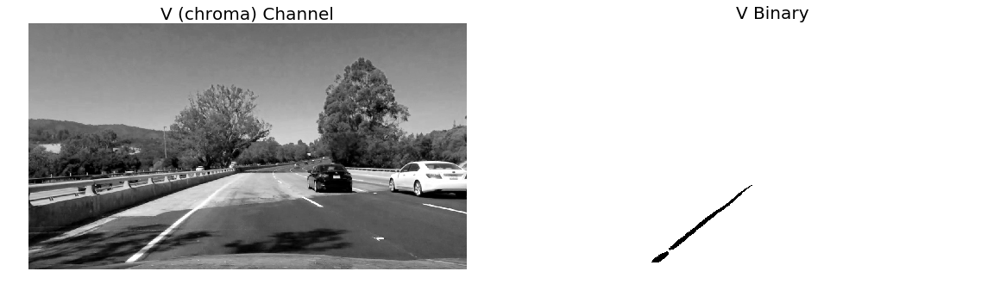

In [24]:
## Vhow channels and binaries side-by-side

img = test4

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(142,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

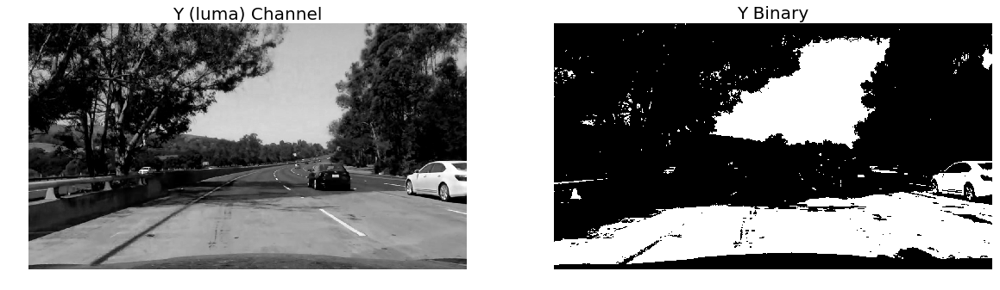

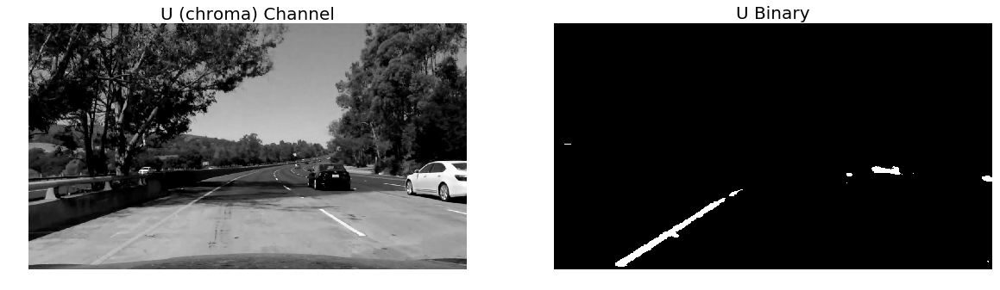

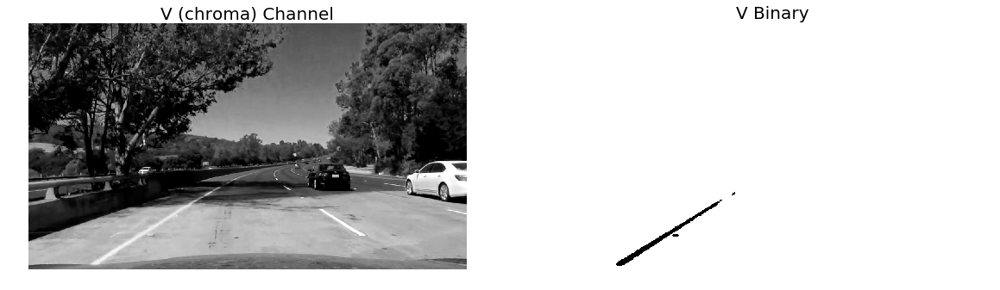

In [25]:
## Vhow channels and binaries side-by-side

img = test5

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(142,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

#### CONCLUSION:
None of the channels in the YUV color space seem to outperform the saturation (S) channel under challenging conditions. Athought the U channel does a nice job identifying yellow lane lines on light colored pavement. But this benefit is probably not enough to consider it for the final solutions. 

#### &nbsp;
### Test Combinations of Different Thresholds
Here we try to incorporate the best and most complimentary methods into one robust approach for identifying lane lines.

#### Stacking Test
This test shows how different thresholds look when stacked into the same image. This helps to identify which methods are most effective and complimentary.

In [26]:
def stack_thresh(img):
    '''Experiment to see how different thresholds compliment one another when stacked together
    in the same image.'''
    
    # Gradient thresholds
    sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
    sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
    mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
    
    # Color thresholds
    clahe_binary = clahe_thresh(img)  # contrast limited adaptive hist. equal.
    s_binary = hls_thresh(img, channel='S', thresh=(120,255))  # saturation channel
    v_binary = hsv_thresh(img, channel='V', thresh=(225,255))  # value channel 
    
    # Different stack combinations
    sxy_stack = np.dstack((np.zeros_like(s_binary), sx_binary*255, sy_binary*255))
    sxs_stack = np.dstack((np.zeros_like(s_binary), sx_binary*255, s_binary*255))
    sv_stack = np.dstack((np.zeros_like(s_binary), s_binary*255, v_binary*255))
    cs_stack = np.dstack((np.zeros_like(s_binary), s_binary*255, clahe_binary))
    
    return sxy_stack, sxs_stack, sv_stack, cs_stack

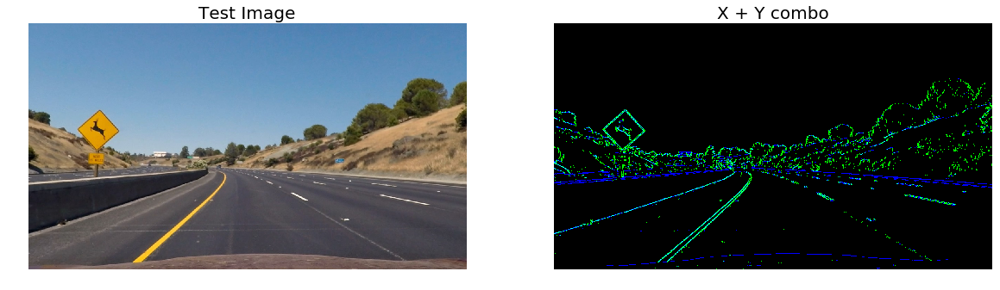

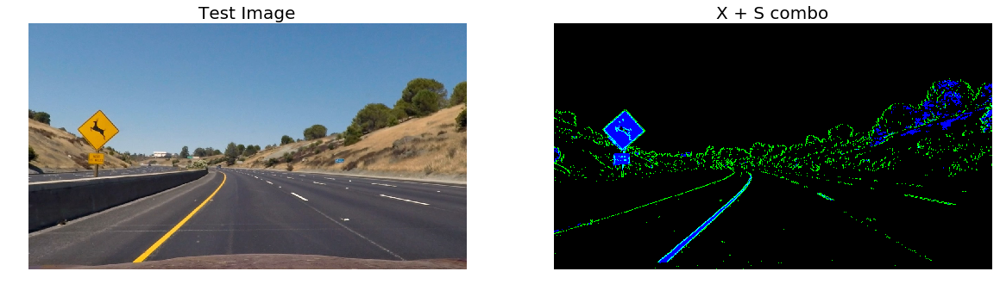

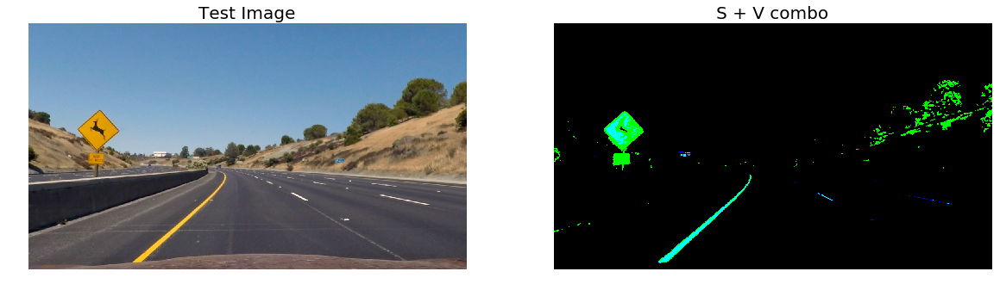

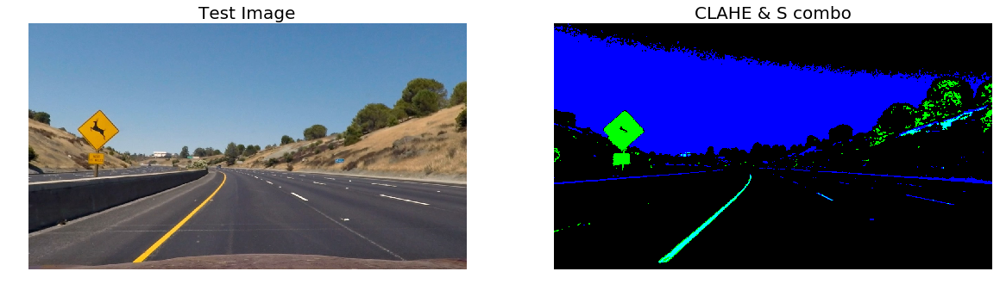

In [59]:
## Show thresholds stacked together in green and blue channels

img = test2

# Create binaries
sxy_stack, sxs_stack, sv_stack, cs_stack = stack_thresh(img)

# Visualize results
show_RGB(img, sxy_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + Y combo')
show_RGB(img, sxs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + S combo')
show_RGB(img, sv_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='S + V combo')
show_RGB(img, cs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='CLAHE & S combo')

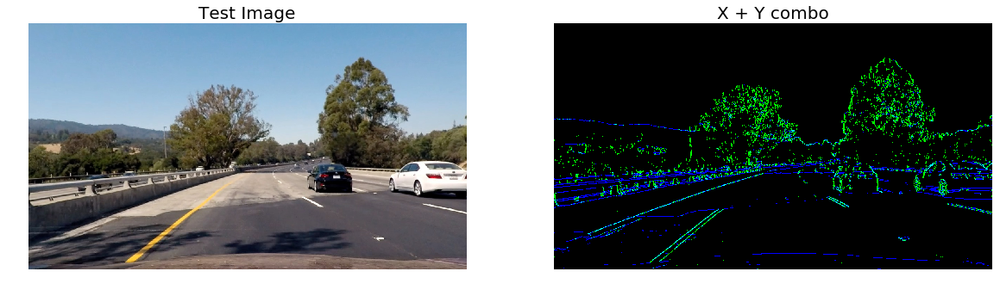

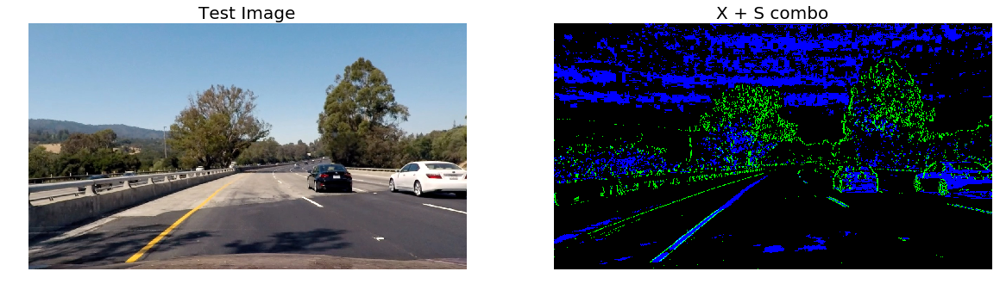

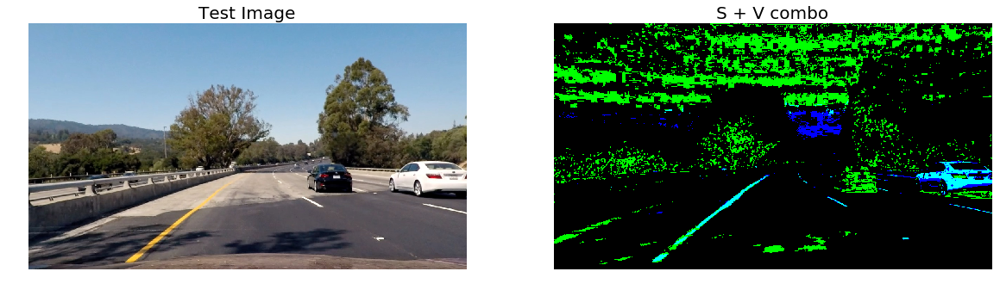

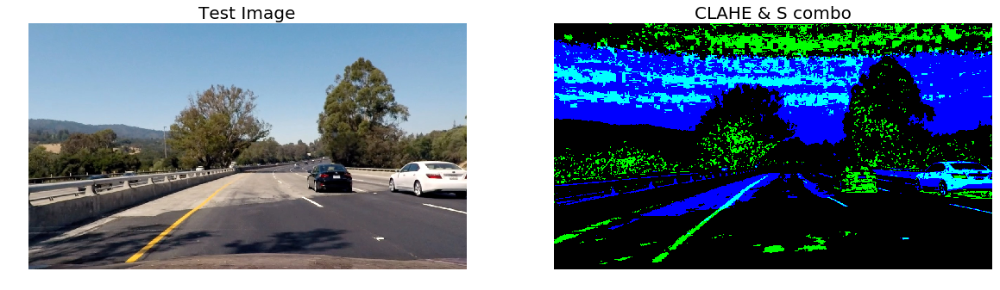

In [60]:
## Show thresholds stacked together in green and blue channels

img = test4

# Create binaries
sxy_stack, sxs_stack, sv_stack, cs_stack = stack_thresh(img)

# Visualize results
show_RGB(img, sxy_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + Y combo')
show_RGB(img, sxs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + S combo')
show_RGB(img, sv_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='S + V combo')
show_RGB(img, cs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='CLAHE & S combo')

#### CONCLUSION:
From the stack test above, it appears the best combonations involve the X gradient, saturation (S) channel, and value (V) channel. We'll explore these further in the next section when we combine them into a single binary. 

#### Thresholds Combination Test
This tests combines different thresholds into a method for identifying lane lines (represented by a single binary image). 

In [27]:
# Combined thresholding function

def comb_thresh(img):
        
    # Gradient thresholds
    sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
    sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
    mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
    
    # Color thresholds
    clahe_binary = clahe_thresh(img)  # contrast limited adaptive hist. equal.
    s_binary = hls_thresh(img, channel='S', thresh=(120,255))  # saturation channel
    v_binary = hsv_thresh(img, channel='V', thresh=(225,255))  # value channel

    ## Combinations of above thresholds:
    
    # Gradients
    grad = np.zeros_like(sx_binary)
    grad[((sx_binary == 1) | (sy_binary == 1)) | (mag_binary == 1)] = 1
    
    # S + V channels
    sv = ((s_binary == 1) | (v_binary == 1))
    
    # CLAHE + SV
    csv = ((clahe_binary == 1) | (s_binary == 1) | (v_binary == 1))
    
    # Gradient + SV
    gradsv = ((grad == 1) | (sv == 1))

    # Return various combinations to test
    return sv, gradsv

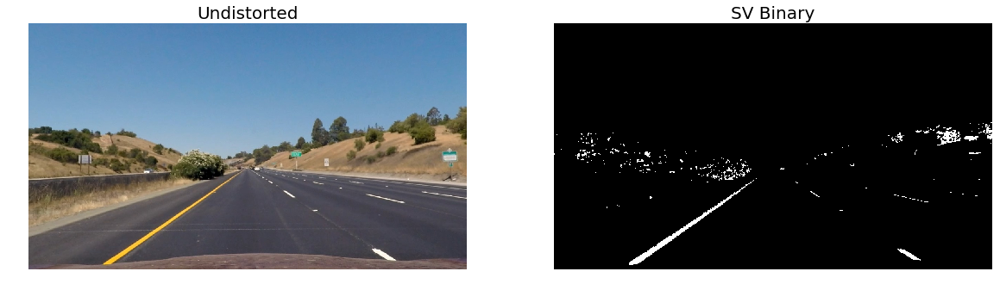

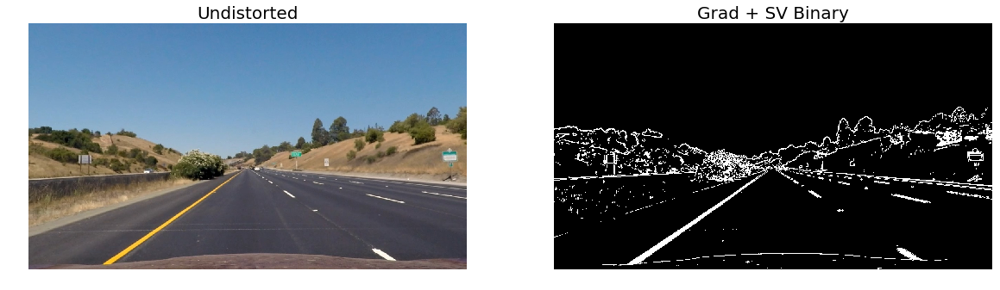

In [30]:
img = straight1

sv, gradsv = comb_thresh(img)
 
show_RGB(img, sv, title2='SV Binary') 
show_RGB(img, gradsv, title2='Grad + SV Binary') 

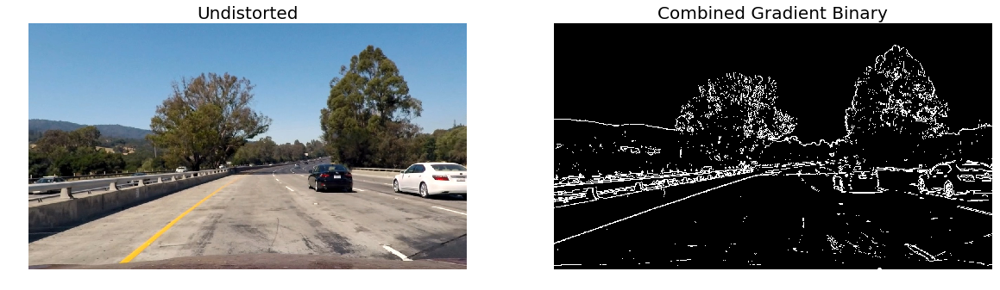

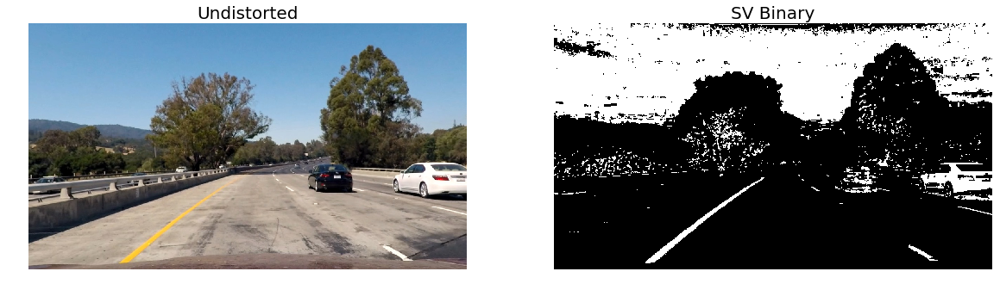

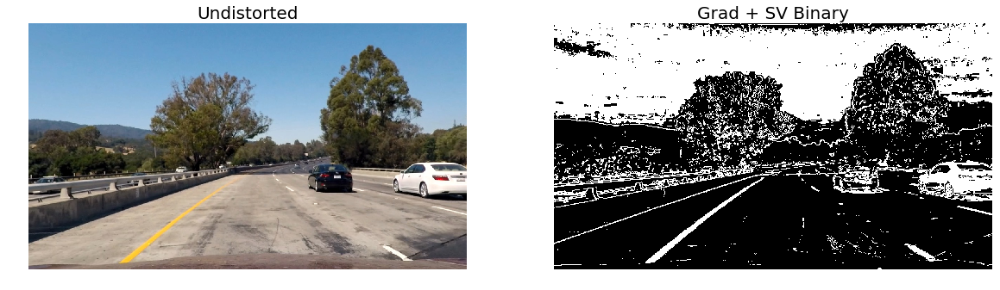

In [238]:
img = test1

grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv = comb_thresh(img)

show_RGB(img, grad, title2='Combined Gradient Binary')
# show_RGB(img, clahe_binary, title2='CLAHE Binary')
# show_RGB(img, s_binary, title2='S Binary') 
# show_RGB(img, v_binary, title2='V Binary') 
show_RGB(img, sv, title2='SV Binary') 
# show_RGB(img, csv, title2='CSV Binary')
show_RGB(img, gradsv, title2='Grad + SV Binary') 

#### CONCLUSION:
It seems the the combination of the saturation (S) and value (V) channels does the cleanest job of identifying lane lines across different driving conditions. The gradient combo (X, Y, and magnitude) captures a lot of other noise in the image besides the lane lines, and doesn't perform well under bad lighting conditions. However, there are instances when the SV+Gradient combonation produces the best results. 

For example, in the two images immediately above, the addition of the Gradient combo picks up distant lane lines beyond the shadow that the SV combo misses. 

So, in the next section, we'll experiment with both the SV (saturation, value) and GSV (gradient, saturation, value) combinations to see which one performs best when we actually detect and draw the lane boundaries. 

---
## Step 4 | Perspective Transform

&nbsp;
### Region of Interest & Perspective Transformation Matrix
Here we define the region of the image we want to focus on when trying to detect the lane lines.

In [31]:
# Perspective transform functions

def get_vertices(img):

    # Get image dimensions
    img_size = (img.shape[1], img.shape[0])
    img_width, img_height = img.shape[1], img.shape[0]
    
    # Define the region of interest
    y_mid = img_size[0]/2       # midpoint of image width y
    x_mid = img_size[1]/2       # midpoint of image height x
    y_up_off = 80               # y offset for upper vertices of ROI polynomial
    y_low_off = 450             # y offset for lower vertices of ROI polynomial
    x_up_off = 110
    x_low_off = 350
    
    points = [
        (y_mid - y_up_off, x_mid + x_up_off),   
        (y_mid + y_up_off, x_mid + x_up_off),
        (y_mid + y_low_off, x_mid + x_low_off),
        (y_mid - y_low_off, x_mid + x_low_off),
    ]
    src = np.float32(points)
    
    # Define warp points as dst 
    dst = np.float32([
        [y_mid - y_low_off, 0],
        [y_mid + y_low_off, 0],
        [y_mid + y_low_off, img_height],
        [y_mid - y_low_off, img_height],
    ])
    
    return src, dst


def perspective_transform(img, src, dst):

    # Calculate perspective transforms
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Apply perspective transformation to image
    img_size = (img.shape[1], img.shape[0])       
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped, M, Minv


def draw_lines(img, vertices):
    points= np.int32([vertices])
    img_lines = cv2.polylines(img, points, True, (0,255,0), thickness=2)
    
    return img_lines

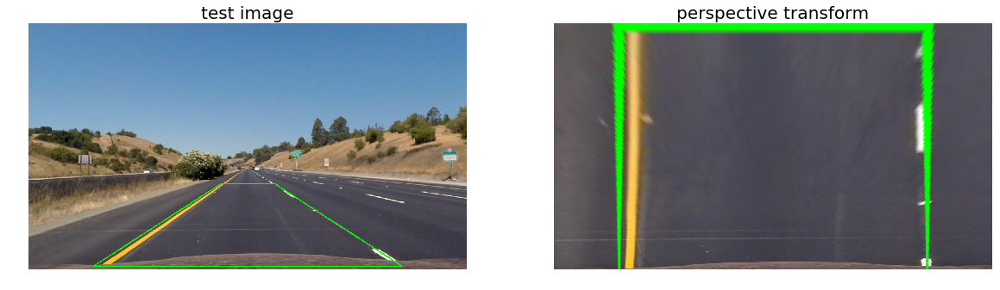

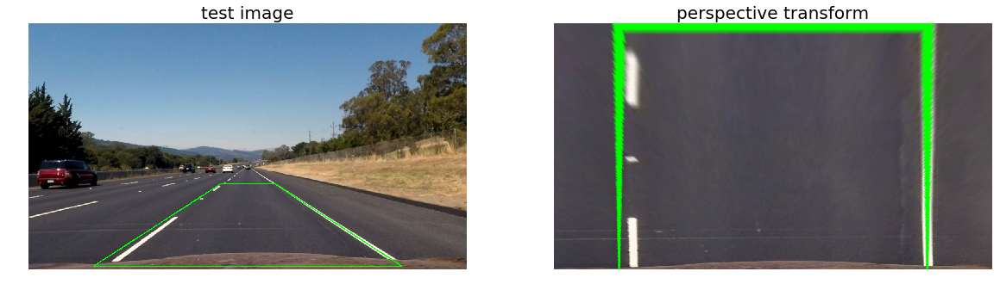

In [32]:
warp_test = np.copy(straight1)

src, dst = get_vertices(warp_test)

warp_test_a = draw_lines(warp_test, src)
warp_test_b = draw_lines(np.copy(straight2), src)

straight1_warp, straight1_M, straight1_Minv = perspective_transform(warp_test_a, src, dst)
straight2_warp, straight2_M, straight2_Minv = perspective_transform(warp_test_b, src, dst)

show_RGB(warp_test_a, straight1_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(warp_test_b, straight2_warp, chan2='BGR', title1='test image', title2='perspective transform') 

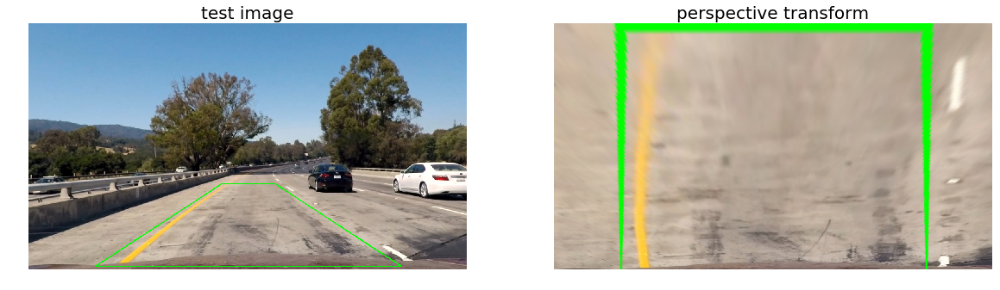

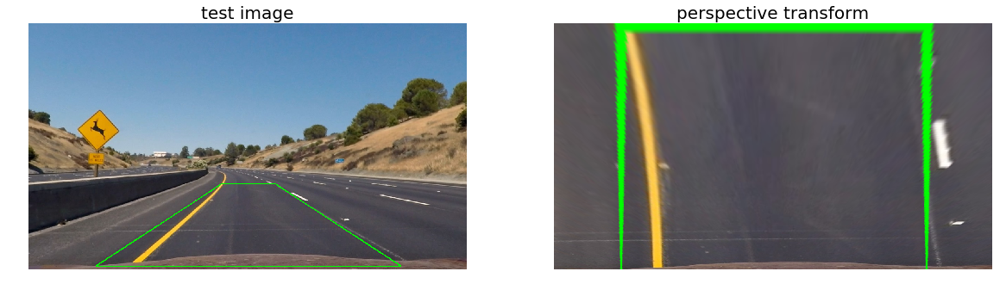

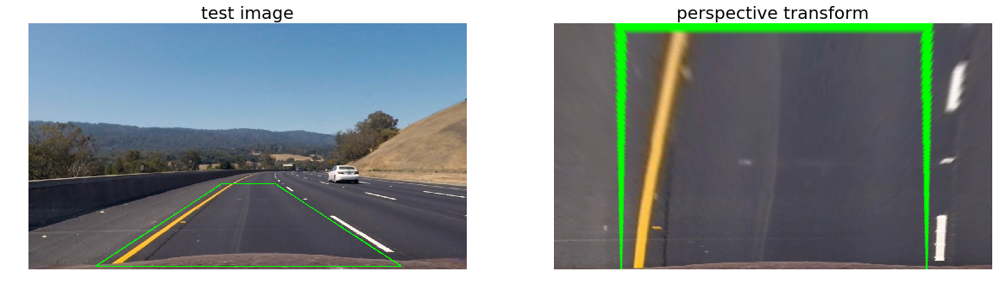

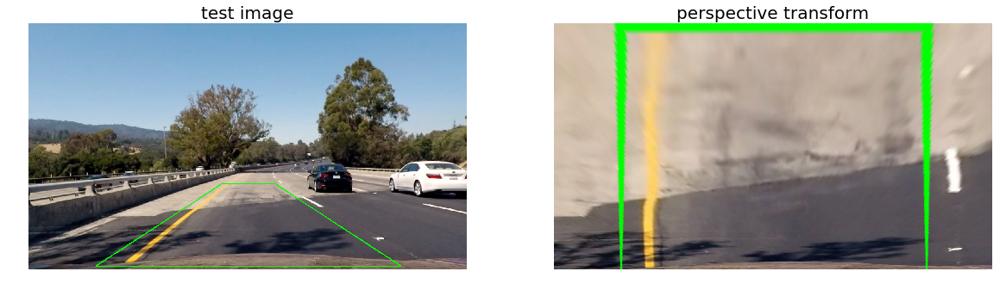

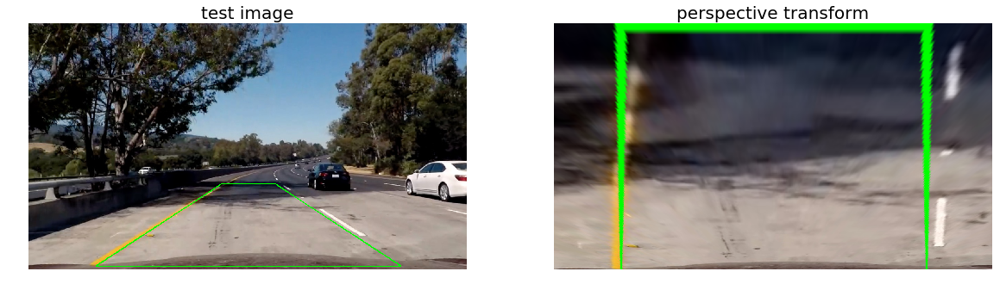

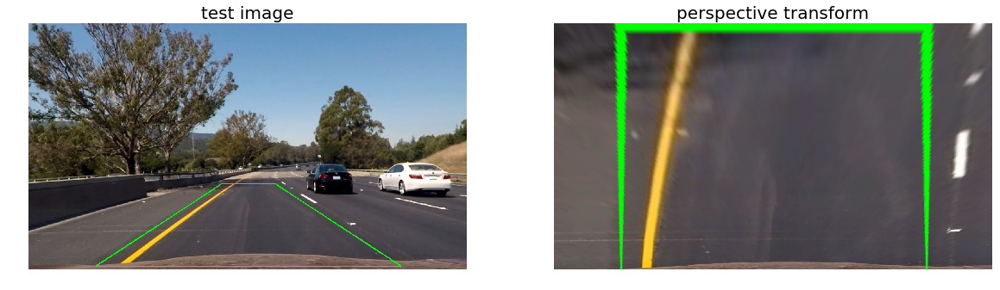

In [339]:
# View perspective transforms for images with curved lane lines

src, dst = get_vertices(test1)

test1_lines = draw_lines(np.copy(test1), src)
test2_lines = draw_lines(np.copy(test2), src)
test3_lines = draw_lines(np.copy(test3), src)
test4_lines = draw_lines(np.copy(test4), src)
test5_lines = draw_lines(np.copy(test5), src)
test6_lines = draw_lines(np.copy(test6), src)

test1_warp, test1_M, test1_Minv = perspective_transform(test1_lines, src, dst)
test2_warp, test2_M, test2_Minv = perspective_transform(test2_lines, src, dst)
test3_warp, test3_M, test3_Minv = perspective_transform(test3_lines, src, dst)
test4_warp, test4_M, test4_Minv = perspective_transform(test4_lines, src, dst)
test5_warp, test5_M, test5_Minv = perspective_transform(test5_lines, src, dst)
test6_warp, test6_M, test6_Minv = perspective_transform(test6_lines, src, dst)

show_RGB(test1_lines, test1_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(test2_lines, test2_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(test3_lines, test3_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(test4_lines, test4_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(test5_lines, test5_warp, chan2='BGR', title1='test image', title2='perspective transform') 
show_RGB(test6_lines, test6_warp, chan2='BGR', title1='test image', title2='perspective transform') 

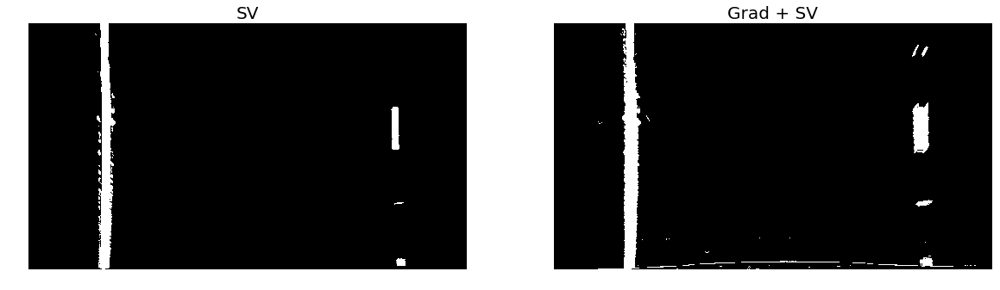

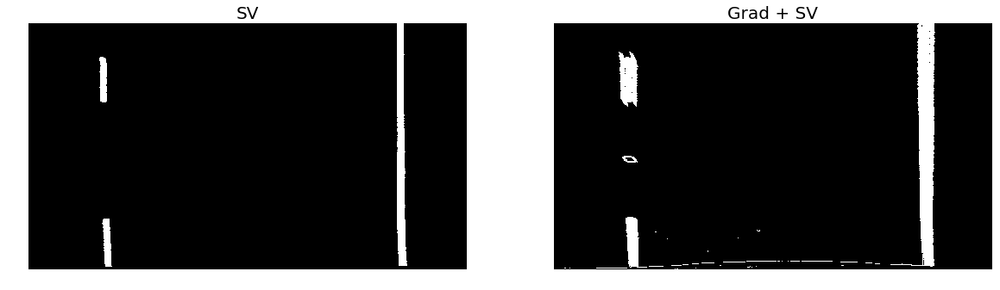

In [342]:
# Preview binary versions of the perspective transforms -- Straight lanes

# Straight1 test image
img_a = straight1
src, dst = get_vertices(img_a)
warped_a, _, _ = perspective_transform(img_a, src, dst)
sv_binary_warp_a, gradsv_binary_warp_a = comb_thresh(warped_a)
show_RGB(sv_binary_warp_a, gradsv_binary_warp_a, chan1='gray', title1='SV', title2='Grad + SV') 

# Straight2 test image
img_b = straight2
src, dst = get_vertices(img_b)
warped_b, _, _ = perspective_transform(img_b, src, dst)
sv_binary_warp_b, gradsv_binary_warp_b = comb_thresh(warped_b)
show_RGB(sv_binary_warp_b, gradsv_binary_warp_b, chan1='gray', title1='SV', title2='Grad + SV')

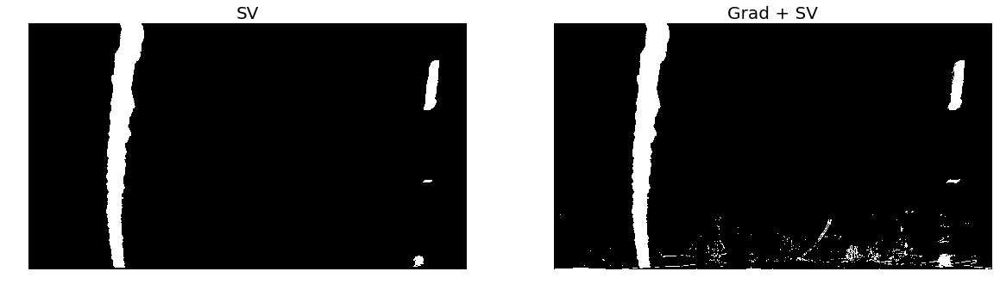

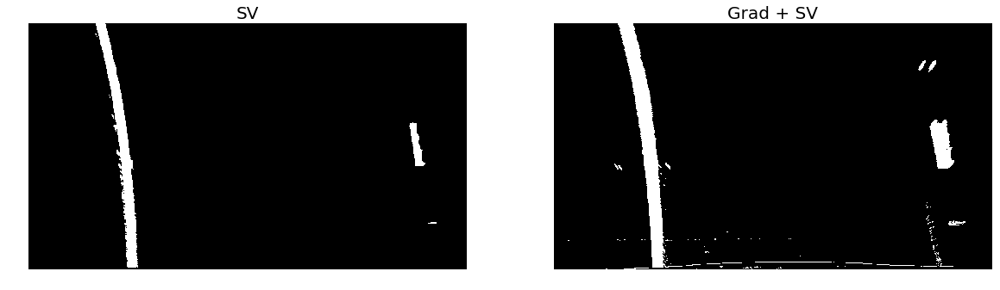

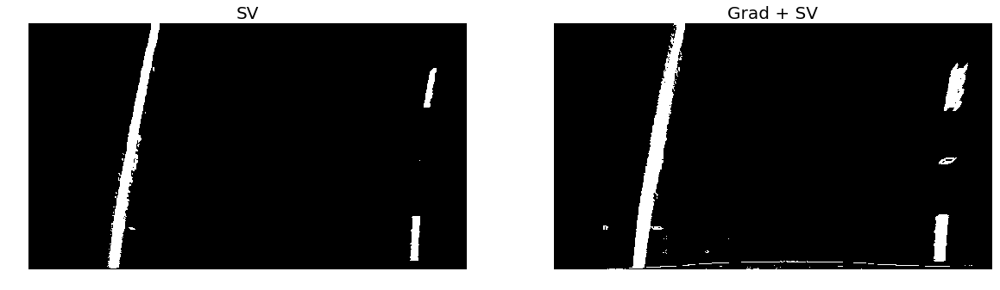

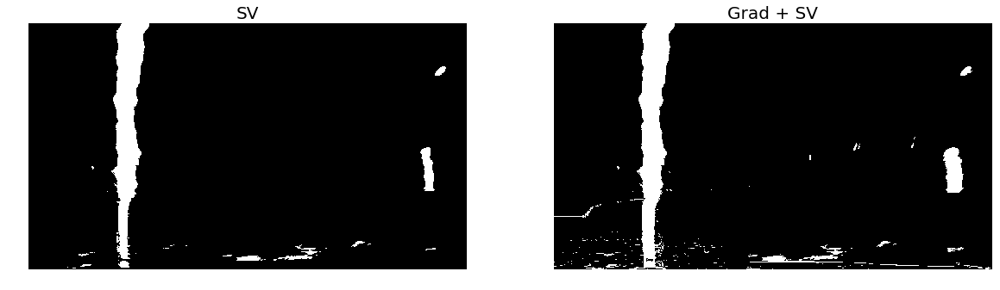

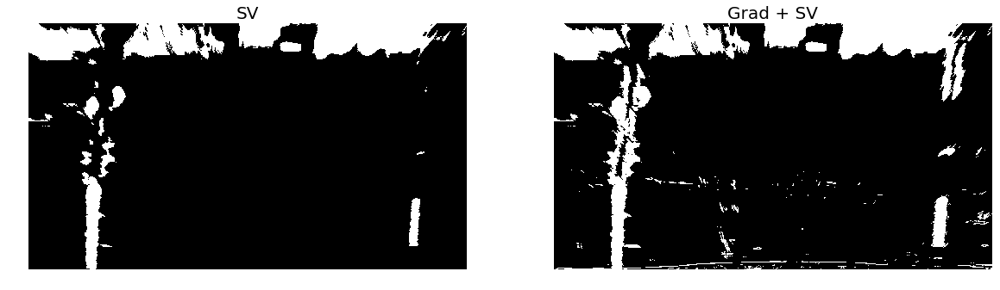

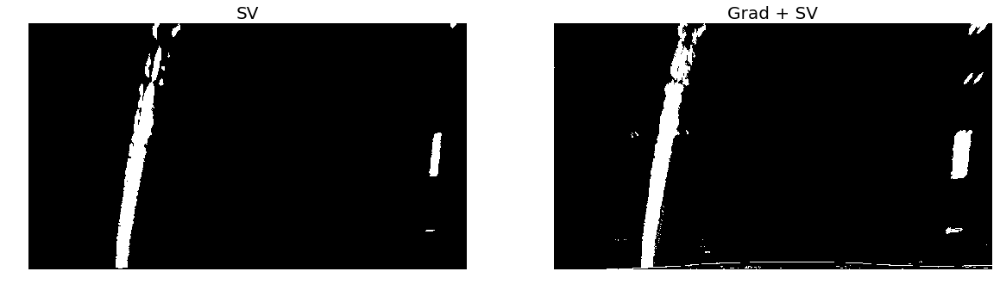

In [344]:
# Preview binary versions of the perspective transforms -- Curved lanes + shadows

img_1, img_2, img_3, img_4, img_5, img_6 = test1, test2, test3, test4, test5, test6

src, dst = get_vertices(img_1)

warped_1, M, Minv = perspective_transform(img_1, src, dst)
warped_2, M, Minv = perspective_transform(img_2, src, dst)
warped_3, M, Minv = perspective_transform(img_3, src, dst)
warped_4, M, Minv = perspective_transform(img_4, src, dst)
warped_5, M, Minv = perspective_transform(img_5, src, dst)
warped_6, M, Minv = perspective_transform(img_6, src, dst)

sv_binary_warp_1, gradsv_binary_warp_1 = comb_thresh(warped_1)
sv_binary_warp_2, gradsv_binary_warp_2 = comb_thresh(warped_2)
sv_binary_warp_3, gradsv_binary_warp_3 = comb_thresh(warped_3)
sv_binary_warp_4, gradsv_binary_warp_4 = comb_thresh(warped_4)
sv_binary_warp_5, gradsv_binary_warp_5 = comb_thresh(warped_5)
sv_binary_warp_6, gradsv_binary_warp_6 = comb_thresh(warped_6)

show_RGB(sv_binary_warp_1, gradsv_binary_warp_1, chan1='gray', title1='SV', title2='Grad + SV') 
show_RGB(sv_binary_warp_2, gradsv_binary_warp_2, chan1='gray', title1='SV', title2='Grad + SV') 
show_RGB(sv_binary_warp_3, gradsv_binary_warp_3, chan1='gray', title1='SV', title2='Grad + SV') 
show_RGB(sv_binary_warp_4, gradsv_binary_warp_4, chan1='gray', title1='SV', title2='Grad + SV') 
show_RGB(sv_binary_warp_5, gradsv_binary_warp_5, chan1='gray', title1='SV', title2='Grad + SV') 
show_RGB(sv_binary_warp_6, gradsv_binary_warp_6, chan1='gray', title1='SV', title2='Grad + SV') 


#### CONCLUSION: 
You can see that there's a trade-off between the two threshold methods. The SV threshold produces cleaner lines but doesn't all of the lines. Whereas the Grad+SV threshold produces binaries with more noise, but captures more of the line fragments.

---
## Step 5 | Detect Lane Pixels and Fit to the Lane Boundary

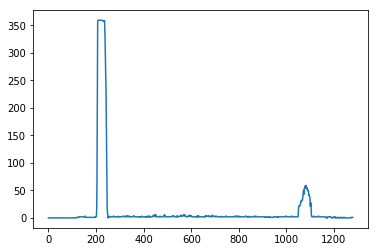

In [365]:
# Preview lane detection histogram

binary_warped = gradsv_binary_warp_a

histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
plt.plot(histogram)

In [75]:
# Use warped binary to identify lane lines using sliding windows approach

def find_lines(binary_warped, show=False):

    # Make sure binary doesn't have float values
    binary_warped = binary_warped.astype('uint8')
    
    if show:
        # Create an output image to draw on and  visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Set the width of the windows +/- margin
    margin = 100
    
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        if show:
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)         
        
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    if show:
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        fig2 = plt.figure(figsize = (10,10)) # create a 5 x 5 figure 
        ax3 = fig2.add_subplot(1, 1, 1)
        ax3.imshow(out_img, interpolation='none')
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')    
        ax3.set_title('Sliding Windows & Polynomial Fit')
        plt.show()  
        
    return left_fit, right_fit

In [76]:
# Function that uses the last frame as reference for fitting the next frame

def use_last_frame(binary_warped, left_fit, right_fit):

    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 30
    left_lane_inds = (
        (nonzerox > (left_fit[0] * (nonzeroy ** 2) + left_fit[1] * nonzeroy + left_fit[2] - margin)) &
        (nonzerox < (left_fit[0] * (nonzeroy ** 2) + left_fit[1] * nonzeroy + left_fit[2] + margin)))
    right_lane_inds = (
        (nonzerox > (right_fit[0] * (nonzeroy ** 2) + right_fit[1] * nonzeroy + right_fit[2] - margin)) &
        (nonzerox < (right_fit[0] * (nonzeroy ** 2) + right_fit[1] * nonzeroy + right_fit[2] + margin)))

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]
    
        
    return left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty, left_lane_inds, right_lane_inds


In [529]:
# Function that shows where the lane lines will be drawn -- visualization purposes only

def visualize_lane_lines(binary_warped, left_fitx, right_fitx, ploty, left_lane_inds, right_lane_inds):
    # Make sure binary doesn't have float values
    binary_warped = binary_warped.astype('uint8')
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    fig = plt.figure(figsize = (10,10)) 
    ax1 = fig.add_subplot(1, 1, 1)
    ax1.imshow(result, interpolation='none')
    ax1.plot(left_fitx, ploty, color='yellow')
    ax1.plot(right_fitx, ploty, color='yellow')    
    ax1.set_title('Lane Lines')
    plt.show()
    

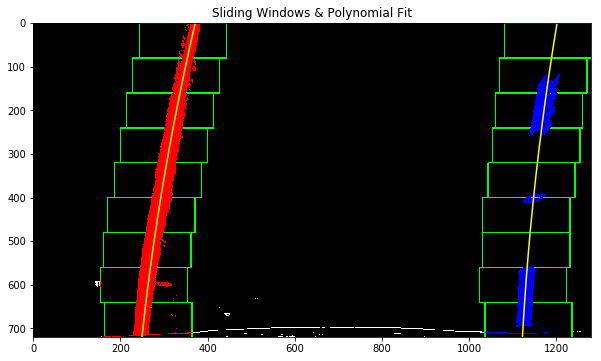

In [461]:
# Preview output of sliding windows and polynomial fit

left_fit, right_fit = find_lines(binary_warped, plot=True)

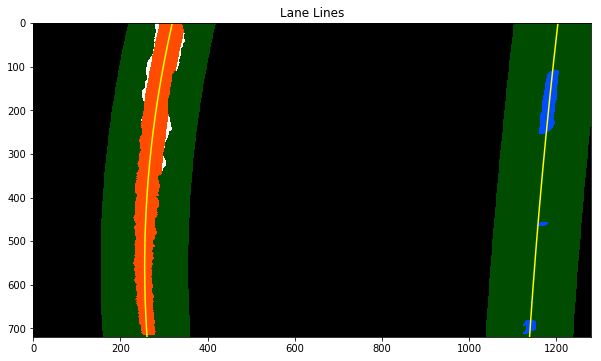

In [531]:
# Preview where the lane lines will be drawn

src, dst = get_vertices(test1)
warped, M, Minv = perspective_transform(test1, src, dst)
binary_warped, gradsv_binary_warp = comb_thresh(warped)
left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty, left_lane_inds, right_lane_inds = \
    use_last_frame(binary, left_fit, right_fit)
visualize_lane_lines(binary, left_fitx, right_fitx, ploty, left_lane_inds, right_lane_inds)

---
## Step 6 | Determine Lane Curvature and Vehicle Position

In [78]:
def radius_center(ploty, leftx, rightx, lefty, righty):
    
    y_eval = np.max(ploty)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30 / 720  # meters per pixel in y dimension
    xm_per_pix = 3.7 / 700  # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)

    # Calculate the new radii of curvature
    left_curve_radius = ((1 + (2 * left_fit_cr[0] * y_eval * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * left_fit_cr[0])
    right_curve_radius = ((1 + (2 * right_fit_cr[0] * y_eval * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * right_fit_cr[0])
    radius = np.mean([left_curve_radius, right_curve_radius])

    left_y_max = np.argmax(lefty)
    right_y_max = np.argmax(righty)
    center_x = (leftx[left_y_max] + rightx[right_y_max])/2
    center_offset = (640 - center_x) * xm_per_pix
    
    
    return radius, center_offset


---
## Step 7 | Overlay the Lane Boundaries onto the Original Image

In [79]:
# Function for drawing complete lane markings back onto the original image

def project_back(binary_warped, original_image, undist, Minv, left_fitx, right_fitx, ploty):
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv,
                                  (original_image.shape[1], original_image.shape[0]))
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    return result

### Smoothing
Here we caculate a **moving average** of the line plotting variables in order to smooth out the resulting lines that will be drawn back onto the original image. 

In [80]:
# Moving average function

def moving_average(radius, center_offset, left, right, plot):

    global count
    if count == 5:
        recent_radius.pop(0)
        recent_center_offset.pop(0)
        recent_left_fitx.pop(0)
        recent_right_fitx.pop(0)
        recent_ploty.pop(0)
    else:
        count += 1
    recent_radius.append(radius)
    recent_center_offset.append(center_offset)
    recent_left_fitx.append(left)
    recent_right_fitx.append(right)
    recent_ploty.append(plot)
    if count > 5:
        exit()

In [81]:
# Set global variables for moving average

count = 0
first = True
left_fitx = None
right_fitx = None
ploty = None
left_fit = None
right_fit = None
leftx = None
rightx = None
lefty = None
righty = None

# Create placeholder lists for storing recent values
recent_radius = []
recent_center_offset = []
recent_left_fitx = []
recent_right_fitx = []
recent_ploty = []


### Final Pipeline

In [82]:
def pipeline(image):

    undist = undistort(image)
    src, dst = get_vertices(undist)
    warped, M, Minv = perspective_transform(undist, src, dst)
    warped_binary_sv, warped_binary = comb_thresh(warped)
    
    global first, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty
    
    if first:
        left_fit, right_fit = find_lines(warped_binary)
        left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty, _, _ = \
            use_last_frame(warped_binary, left_fit, right_fit)
        first = False

    left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx, lefty, righty, _, _ = \
        use_last_frame(warped_binary, left_fit, right_fit)
    
    radius, center_offset = radius_center(ploty, leftx, rightx, lefty, righty)

    moving_average(radius, center_offset, left_fitx, right_fitx, ploty)

    result = project_back(warped_binary, image, undist, Minv,
                          np.add.reduce(recent_left_fitx) / count,
                          np.add.reduce(recent_right_fitx) / count,
                          np.add.reduce(recent_ploty) / count)

    cv2.putText(result, 'Radius: {0:.1f}m '.format(np.add.reduce(recent_radius) / count), (50, 50), 
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, bottomLeftOrigin=False)
    cv2.putText(result, 'Center Offset: {0:.2f}m'.format(np.add.reduce(recent_center_offset) / count), (50, 100),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, bottomLeftOrigin=False)
    
    
    return result

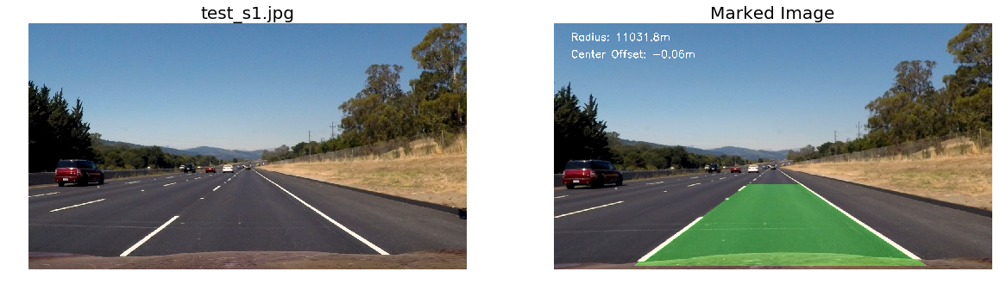

In [83]:
image_s1 = cv2.imread('test_images/straight_lines2.jpg')
test_s1_marked = pipeline(image_s1)
show_RGB(image_s1, test_s1_marked, chan1='BGR', chan2='BGR', title1='test_s1.jpg', title2='Marked Image')


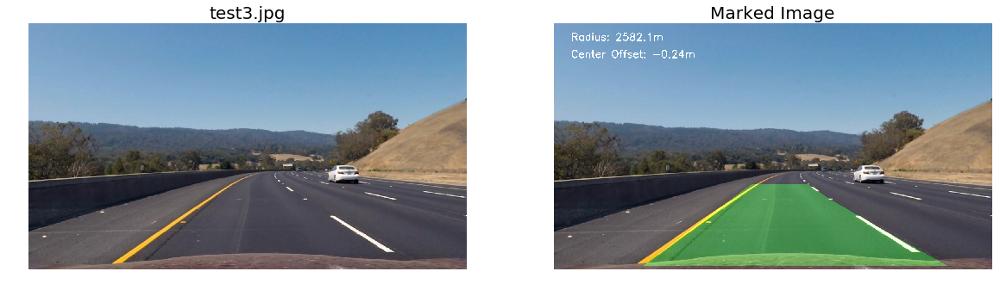

In [56]:
image3 = cv2.imread('test_images/test3.jpg')
test3_marked = pipeline(image3)
show_RGB(test3, test3_marked, chan1='BGR', chan2='BGR', title1='test3.jpg', title2='Marked Image')


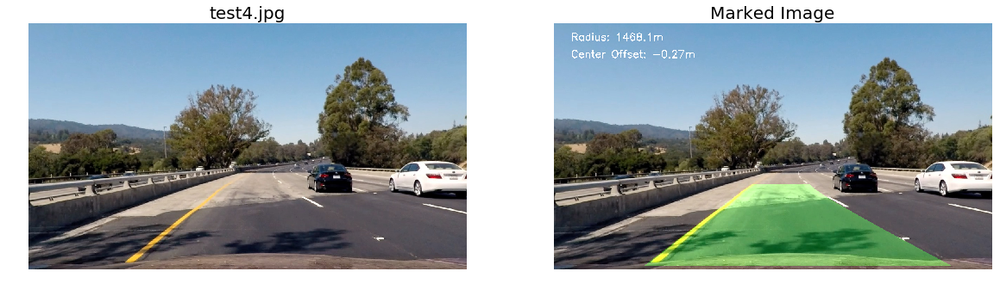

In [57]:
image4 = cv2.imread('test_images/test4.jpg')
test4_marked = pipeline(image4)
show_RGB(test4, test4_marked, chan1='BGR', chan2='BGR', title1='test4.jpg', title2='Marked Image')


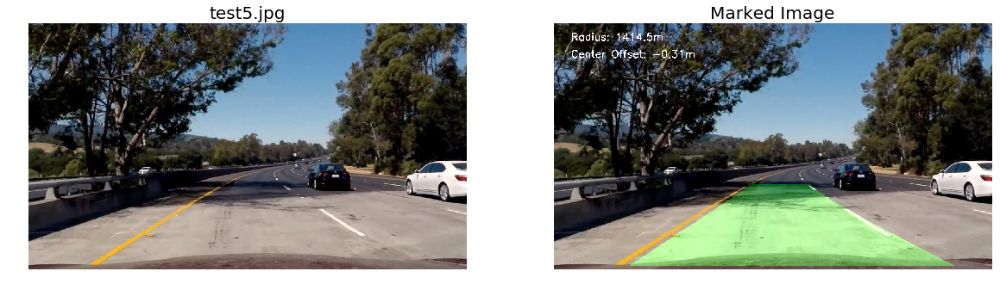

In [58]:
image5 = cv2.imread('test_images/test5.jpg')
test5_marked = pipeline(image5)
show_RGB(test5, test5_marked, chan1='BGR', chan2='BGR', title1='test5.jpg', title2='Marked Image')


---
## Step 8 | Output Video
Here we need create a visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position with respect to center.

In [88]:
def video_pipeline(video_file, output_file, process_method):
    """
    :param     video_file: source video file path
    :param    output_file: output video file path
    :param process_method: the callback function which is used to process the video per frame
    :return:
    """
    clip = VideoFileClip(video_file)
    processed_clip = clip.fl_image(process_method)  # NOTE: this function expects color images!!
    processed_clip.write_videofile(output_file, audio=False);

In [89]:
video_pipeline("project_video.mp4", "project_video_out4.mp4", pipeline);

[MoviePy] >>>> Building video project_video_out4.mp4
[MoviePy] Writing video project_video_out4.mp4









  0%|          | 0/1261 [00:00<?, ?it/s]






  0%|          | 1/1261 [00:00<03:32,  5.93it/s]






  0%|          | 2/1261 [00:00<03:28,  6.04it/s]






  0%|          | 3/1261 [00:00<03:26,  6.08it/s]






  0%|          | 4/1261 [00:00<03:25,  6.10it/s]






  0%|          | 5/1261 [00:00<03:28,  6.04it/s]






  0%|          | 6/1261 [00:00<03:29,  5.98it/s]






  1%|          | 7/1261 [00:01<03:29,  5.98it/s]






  1%|          | 8/1261 [00:01<03:28,  6.01it/s]






  1%|          | 9/1261 [00:01<03:34,  5.83it/s]






  1%|          | 10/1261 [00:01<03:38,  5.74it/s]






  1%|          | 11/1261 [00:01<03:38,  5.71it/s]






  1%|          | 12/1261 [00:02<03:38,  5.72it/s]






  1%|          | 13/1261 [00:02<03:41,  5.64it/s]






  1%|          | 14/1261 [00:02<03:40,  5.67it/s]






  1%|          | 15/1261 [00:02<03:36,  5.76it/s]






  1%|▏         | 16/1261 [00:02<03:34,  5.80it/s]






  1%|▏         | 17/1261 [00:02<03:37,  5.72it/s]






  1

  8%|▊         | 106/1261 [00:17<03:05,  6.23it/s]






  8%|▊         | 107/1261 [00:18<03:05,  6.23it/s]






  9%|▊         | 108/1261 [00:18<03:02,  6.31it/s]






  9%|▊         | 109/1261 [00:18<03:02,  6.30it/s]






  9%|▊         | 110/1261 [00:18<03:02,  6.31it/s]






  9%|▉         | 111/1261 [00:18<03:03,  6.25it/s]






  9%|▉         | 112/1261 [00:18<03:02,  6.29it/s]






  9%|▉         | 113/1261 [00:19<03:00,  6.37it/s]






  9%|▉         | 114/1261 [00:19<03:00,  6.34it/s]






  9%|▉         | 115/1261 [00:19<03:02,  6.28it/s]






  9%|▉         | 116/1261 [00:19<03:02,  6.28it/s]






  9%|▉         | 117/1261 [00:19<03:07,  6.09it/s]






  9%|▉         | 118/1261 [00:19<03:09,  6.03it/s]






  9%|▉         | 119/1261 [00:20<03:09,  6.03it/s]






 10%|▉         | 120/1261 [00:20<03:11,  5.95it/s]






 10%|▉         | 121/1261 [00:20<03:11,  5.94it/s]






 10%|▉         | 122/1261 [00:20<03:14,  5.84it/s]






 10%|▉         | 123/1261 [00:2

 17%|█▋        | 211/1261 [00:35<02:46,  6.32it/s]






 17%|█▋        | 212/1261 [00:35<02:45,  6.35it/s]






 17%|█▋        | 213/1261 [00:35<02:45,  6.32it/s]






 17%|█▋        | 214/1261 [00:35<02:46,  6.30it/s]






 17%|█▋        | 215/1261 [00:35<02:47,  6.26it/s]






 17%|█▋        | 216/1261 [00:35<02:46,  6.27it/s]






 17%|█▋        | 217/1261 [00:36<02:45,  6.32it/s]






 17%|█▋        | 218/1261 [00:36<02:44,  6.33it/s]






 17%|█▋        | 219/1261 [00:36<02:44,  6.35it/s]






 17%|█▋        | 220/1261 [00:36<02:44,  6.34it/s]






 18%|█▊        | 221/1261 [00:36<02:44,  6.31it/s]






 18%|█▊        | 222/1261 [00:36<02:44,  6.33it/s]






 18%|█▊        | 223/1261 [00:37<02:44,  6.29it/s]






 18%|█▊        | 224/1261 [00:37<02:46,  6.23it/s]






 18%|█▊        | 225/1261 [00:37<02:49,  6.12it/s]






 18%|█▊        | 226/1261 [00:37<02:49,  6.12it/s]






 18%|█▊        | 227/1261 [00:37<02:49,  6.11it/s]






 18%|█▊        | 228/1261 [00:3

 25%|██▌       | 316/1261 [00:52<02:31,  6.23it/s]






 25%|██▌       | 317/1261 [00:52<02:33,  6.16it/s]






 25%|██▌       | 318/1261 [00:53<02:32,  6.18it/s]






 25%|██▌       | 319/1261 [00:53<02:31,  6.21it/s]






 25%|██▌       | 320/1261 [00:53<02:32,  6.16it/s]






 25%|██▌       | 321/1261 [00:53<02:32,  6.18it/s]






 26%|██▌       | 322/1261 [00:53<02:34,  6.09it/s]






 26%|██▌       | 323/1261 [00:53<02:38,  5.92it/s]






 26%|██▌       | 324/1261 [00:54<02:37,  5.96it/s]






 26%|██▌       | 325/1261 [00:54<02:39,  5.88it/s]






 26%|██▌       | 326/1261 [00:54<02:35,  6.01it/s]






 26%|██▌       | 327/1261 [00:54<02:37,  5.92it/s]






 26%|██▌       | 328/1261 [00:54<02:38,  5.89it/s]






 26%|██▌       | 329/1261 [00:54<02:38,  5.87it/s]






 26%|██▌       | 330/1261 [00:55<02:35,  6.00it/s]






 26%|██▌       | 331/1261 [00:55<02:33,  6.05it/s]






 26%|██▋       | 332/1261 [00:55<02:34,  6.03it/s]






 26%|██▋       | 333/1261 [00:5

 33%|███▎      | 421/1261 [01:11<02:24,  5.82it/s]






 33%|███▎      | 422/1261 [01:11<02:25,  5.75it/s]






 34%|███▎      | 423/1261 [01:11<02:24,  5.81it/s]






 34%|███▎      | 424/1261 [01:12<02:20,  5.96it/s]






 34%|███▎      | 425/1261 [01:12<02:19,  6.01it/s]






 34%|███▍      | 426/1261 [01:12<02:18,  6.03it/s]






 34%|███▍      | 427/1261 [01:12<02:18,  6.03it/s]






 34%|███▍      | 428/1261 [01:12<02:23,  5.82it/s]






 34%|███▍      | 429/1261 [01:12<02:24,  5.76it/s]






 34%|███▍      | 430/1261 [01:13<02:24,  5.73it/s]






 34%|███▍      | 431/1261 [01:13<02:23,  5.77it/s]






 34%|███▍      | 432/1261 [01:13<02:23,  5.79it/s]






 34%|███▍      | 433/1261 [01:13<02:21,  5.86it/s]






 34%|███▍      | 434/1261 [01:13<02:23,  5.75it/s]






 34%|███▍      | 435/1261 [01:13<02:27,  5.59it/s]






 35%|███▍      | 436/1261 [01:14<02:25,  5.67it/s]






 35%|███▍      | 437/1261 [01:14<02:27,  5.58it/s]






 35%|███▍      | 438/1261 [01:1

 42%|████▏     | 526/1261 [01:29<02:03,  5.95it/s]






 42%|████▏     | 527/1261 [01:29<02:04,  5.89it/s]






 42%|████▏     | 528/1261 [01:29<02:06,  5.78it/s]






 42%|████▏     | 529/1261 [01:30<02:09,  5.64it/s]






 42%|████▏     | 530/1261 [01:30<02:10,  5.62it/s]






 42%|████▏     | 531/1261 [01:30<02:11,  5.57it/s]






 42%|████▏     | 532/1261 [01:30<02:11,  5.56it/s]






 42%|████▏     | 533/1261 [01:30<02:12,  5.48it/s]






 42%|████▏     | 534/1261 [01:31<02:09,  5.62it/s]






 42%|████▏     | 535/1261 [01:31<02:06,  5.73it/s]






 43%|████▎     | 536/1261 [01:31<02:05,  5.78it/s]






 43%|████▎     | 537/1261 [01:31<02:05,  5.75it/s]






 43%|████▎     | 538/1261 [01:31<02:07,  5.66it/s]






 43%|████▎     | 539/1261 [01:31<02:07,  5.65it/s]






 43%|████▎     | 540/1261 [01:32<02:08,  5.62it/s]






 43%|████▎     | 541/1261 [01:32<02:09,  5.57it/s]






 43%|████▎     | 542/1261 [01:32<02:07,  5.64it/s]






 43%|████▎     | 543/1261 [01:3

 50%|█████     | 631/1261 [01:47<01:42,  6.15it/s]






 50%|█████     | 632/1261 [01:47<01:42,  6.14it/s]






 50%|█████     | 633/1261 [01:47<01:43,  6.07it/s]






 50%|█████     | 634/1261 [01:47<01:43,  6.05it/s]






 50%|█████     | 635/1261 [01:47<01:43,  6.05it/s]






 50%|█████     | 636/1261 [01:48<01:43,  6.03it/s]






 51%|█████     | 637/1261 [01:48<01:42,  6.07it/s]






 51%|█████     | 638/1261 [01:48<01:43,  6.01it/s]






 51%|█████     | 639/1261 [01:48<01:43,  6.01it/s]






 51%|█████     | 640/1261 [01:48<01:43,  6.00it/s]






 51%|█████     | 641/1261 [01:48<01:43,  6.02it/s]






 51%|█████     | 642/1261 [01:49<01:46,  5.82it/s]






 51%|█████     | 643/1261 [01:49<01:47,  5.74it/s]






 51%|█████     | 644/1261 [01:49<01:48,  5.67it/s]






 51%|█████     | 645/1261 [01:49<01:49,  5.62it/s]






 51%|█████     | 646/1261 [01:49<01:48,  5.69it/s]






 51%|█████▏    | 647/1261 [01:50<01:46,  5.78it/s]






 51%|█████▏    | 648/1261 [01:5

 58%|█████▊    | 736/1261 [02:05<01:30,  5.79it/s]






 58%|█████▊    | 737/1261 [02:05<01:31,  5.75it/s]






 59%|█████▊    | 738/1261 [02:05<01:31,  5.72it/s]






 59%|█████▊    | 739/1261 [02:05<01:31,  5.73it/s]






 59%|█████▊    | 740/1261 [02:06<01:31,  5.66it/s]






 59%|█████▉    | 741/1261 [02:06<01:31,  5.69it/s]






 59%|█████▉    | 742/1261 [02:06<01:29,  5.78it/s]






 59%|█████▉    | 743/1261 [02:06<01:28,  5.87it/s]






 59%|█████▉    | 744/1261 [02:06<01:26,  5.95it/s]






 59%|█████▉    | 745/1261 [02:06<01:26,  5.96it/s]






 59%|█████▉    | 746/1261 [02:07<01:26,  5.97it/s]






 59%|█████▉    | 747/1261 [02:07<01:27,  5.86it/s]






 59%|█████▉    | 748/1261 [02:07<01:29,  5.72it/s]






 59%|█████▉    | 749/1261 [02:07<01:30,  5.65it/s]






 59%|█████▉    | 750/1261 [02:07<01:30,  5.62it/s]






 60%|█████▉    | 751/1261 [02:07<01:31,  5.60it/s]






 60%|█████▉    | 752/1261 [02:08<01:31,  5.57it/s]






 60%|█████▉    | 753/1261 [02:0

 67%|██████▋   | 841/1261 [02:23<01:14,  5.67it/s]






 67%|██████▋   | 842/1261 [02:24<01:13,  5.73it/s]






 67%|██████▋   | 843/1261 [02:24<01:11,  5.84it/s]






 67%|██████▋   | 844/1261 [02:24<01:10,  5.90it/s]






 67%|██████▋   | 845/1261 [02:24<01:09,  5.95it/s]






 67%|██████▋   | 846/1261 [02:24<01:08,  6.02it/s]






 67%|██████▋   | 847/1261 [02:24<01:08,  6.05it/s]






 67%|██████▋   | 848/1261 [02:25<01:09,  5.96it/s]






 67%|██████▋   | 849/1261 [02:25<01:11,  5.80it/s]






 67%|██████▋   | 850/1261 [02:25<01:12,  5.69it/s]






 67%|██████▋   | 851/1261 [02:25<01:12,  5.64it/s]






 68%|██████▊   | 852/1261 [02:25<01:14,  5.48it/s]






 68%|██████▊   | 853/1261 [02:25<01:14,  5.49it/s]






 68%|██████▊   | 854/1261 [02:26<01:14,  5.49it/s]






 68%|██████▊   | 855/1261 [02:26<01:13,  5.55it/s]






 68%|██████▊   | 856/1261 [02:26<01:11,  5.65it/s]






 68%|██████▊   | 857/1261 [02:26<01:10,  5.73it/s]






 68%|██████▊   | 858/1261 [02:2

 75%|███████▌  | 946/1261 [02:41<00:52,  6.01it/s]






 75%|███████▌  | 947/1261 [02:41<00:52,  5.95it/s]






 75%|███████▌  | 948/1261 [02:42<00:53,  5.91it/s]






 75%|███████▌  | 949/1261 [02:42<00:52,  5.95it/s]






 75%|███████▌  | 950/1261 [02:42<00:51,  5.99it/s]






 75%|███████▌  | 951/1261 [02:42<00:51,  6.07it/s]






 75%|███████▌  | 952/1261 [02:42<00:50,  6.08it/s]






 76%|███████▌  | 953/1261 [02:42<00:50,  6.07it/s]






 76%|███████▌  | 954/1261 [02:43<00:50,  6.07it/s]






 76%|███████▌  | 955/1261 [02:43<00:50,  6.07it/s]






 76%|███████▌  | 956/1261 [02:43<00:50,  6.03it/s]






 76%|███████▌  | 957/1261 [02:43<00:50,  6.03it/s]






 76%|███████▌  | 958/1261 [02:43<00:50,  5.97it/s]






 76%|███████▌  | 959/1261 [02:43<00:50,  6.04it/s]






 76%|███████▌  | 960/1261 [02:44<00:49,  6.06it/s]






 76%|███████▌  | 961/1261 [02:44<00:48,  6.13it/s]






 76%|███████▋  | 962/1261 [02:44<00:49,  6.08it/s]






 76%|███████▋  | 963/1261 [02:4

 83%|████████▎ | 1050/1261 [02:59<00:35,  5.98it/s]






 83%|████████▎ | 1051/1261 [02:59<00:34,  6.03it/s]






 83%|████████▎ | 1052/1261 [02:59<00:34,  6.04it/s]






 84%|████████▎ | 1053/1261 [02:59<00:34,  6.11it/s]






 84%|████████▎ | 1054/1261 [03:00<00:38,  5.34it/s]






 84%|████████▎ | 1055/1261 [03:00<00:37,  5.52it/s]






 84%|████████▎ | 1056/1261 [03:00<00:37,  5.54it/s]






 84%|████████▍ | 1057/1261 [03:00<00:38,  5.32it/s]






 84%|████████▍ | 1058/1261 [03:00<00:37,  5.46it/s]






 84%|████████▍ | 1059/1261 [03:01<00:36,  5.60it/s]






 84%|████████▍ | 1060/1261 [03:01<00:36,  5.58it/s]






 84%|████████▍ | 1061/1261 [03:01<00:35,  5.63it/s]






 84%|████████▍ | 1062/1261 [03:01<00:35,  5.66it/s]






 84%|████████▍ | 1063/1261 [03:01<00:34,  5.70it/s]






 84%|████████▍ | 1064/1261 [03:01<00:33,  5.84it/s]






 84%|████████▍ | 1065/1261 [03:02<00:33,  5.87it/s]






 85%|████████▍ | 1066/1261 [03:02<00:33,  5.86it/s]






 85%|████████▍

 91%|█████████▏| 1153/1261 [03:17<00:18,  5.86it/s]






 92%|█████████▏| 1154/1261 [03:17<00:18,  5.92it/s]






 92%|█████████▏| 1155/1261 [03:17<00:17,  5.90it/s]






 92%|█████████▏| 1156/1261 [03:17<00:18,  5.74it/s]






 92%|█████████▏| 1157/1261 [03:17<00:18,  5.70it/s]






 92%|█████████▏| 1158/1261 [03:18<00:18,  5.68it/s]






 92%|█████████▏| 1159/1261 [03:18<00:17,  5.79it/s]






 92%|█████████▏| 1160/1261 [03:18<00:17,  5.83it/s]






 92%|█████████▏| 1161/1261 [03:18<00:17,  5.85it/s]






 92%|█████████▏| 1162/1261 [03:18<00:17,  5.75it/s]






 92%|█████████▏| 1163/1261 [03:18<00:17,  5.76it/s]






 92%|█████████▏| 1164/1261 [03:19<00:16,  5.77it/s]






 92%|█████████▏| 1165/1261 [03:19<00:16,  5.81it/s]






 92%|█████████▏| 1166/1261 [03:19<00:16,  5.77it/s]






 93%|█████████▎| 1167/1261 [03:19<00:16,  5.82it/s]






 93%|█████████▎| 1168/1261 [03:19<00:16,  5.80it/s]






 93%|█████████▎| 1169/1261 [03:19<00:15,  5.78it/s]






 93%|█████████

100%|█████████▉| 1256/1261 [03:34<00:00,  5.99it/s]






100%|█████████▉| 1257/1261 [03:34<00:00,  5.97it/s]






100%|█████████▉| 1258/1261 [03:34<00:00,  6.04it/s]






100%|█████████▉| 1259/1261 [03:35<00:00,  5.95it/s]






100%|█████████▉| 1260/1261 [03:35<00:00,  5.80it/s]








[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out4.mp4 



In [91]:
video_pipeline("challenge_video.mp4", "challenge_video_out1.mp4", pipeline)


[MoviePy] >>>> Building video challenge_video_out1.mp4
[MoviePy] Writing video challenge_video_out1.mp4









  0%|          | 0/485 [00:00<?, ?it/s]






  0%|          | 1/485 [00:00<01:14,  6.50it/s]






  0%|          | 2/485 [00:00<01:14,  6.46it/s]






  1%|          | 3/485 [00:00<01:14,  6.43it/s]






  1%|          | 4/485 [00:00<01:14,  6.47it/s]






  1%|          | 5/485 [00:00<01:15,  6.39it/s]






  1%|          | 6/485 [00:00<01:15,  6.36it/s]






  1%|▏         | 7/485 [00:01<01:15,  6.32it/s]






  2%|▏         | 8/485 [00:01<01:16,  6.26it/s]






  2%|▏         | 9/485 [00:01<01:19,  5.98it/s]






  2%|▏         | 10/485 [00:01<01:19,  5.95it/s]






  2%|▏         | 11/485 [00:01<01:18,  6.04it/s]






  2%|▏         | 12/485 [00:01<01:17,  6.09it/s]






  3%|▎         | 13/485 [00:02<01:18,  6.05it/s]






  3%|▎         | 14/485 [00:02<01:19,  5.91it/s]






  3%|▎         | 15/485 [00:02<01:19,  5.94it/s]






  3%|▎         | 16/485 [00:02<01:18,  5.98it/s]






  4%|▎         | 17/485 [00:02<01:16,  6.09it/s]






  4%|▎         | 18/4

 22%|██▏       | 107/485 [00:17<00:59,  6.35it/s]






 22%|██▏       | 108/485 [00:17<00:58,  6.41it/s]






 22%|██▏       | 109/485 [00:17<00:59,  6.36it/s]






 23%|██▎       | 110/485 [00:17<00:57,  6.49it/s]






 23%|██▎       | 111/485 [00:17<00:56,  6.58it/s]






 23%|██▎       | 112/485 [00:17<00:56,  6.61it/s]






 23%|██▎       | 113/485 [00:17<00:55,  6.69it/s]






 24%|██▎       | 114/485 [00:18<00:55,  6.73it/s]






 24%|██▎       | 115/485 [00:18<00:55,  6.61it/s]






 24%|██▍       | 116/485 [00:18<00:58,  6.36it/s]






 24%|██▍       | 117/485 [00:18<00:57,  6.36it/s]






 24%|██▍       | 118/485 [00:18<00:55,  6.63it/s]






 25%|██▍       | 119/485 [00:18<00:53,  6.85it/s]






 25%|██▍       | 120/485 [00:18<00:56,  6.49it/s]






 25%|██▍       | 121/485 [00:19<00:59,  6.11it/s]






 25%|██▌       | 122/485 [00:19<01:00,  6.01it/s]






 25%|██▌       | 123/485 [00:19<00:59,  6.09it/s]






 26%|██▌       | 124/485 [00:19<00:57,  6.29it/s

 44%|████▍     | 213/485 [00:33<00:42,  6.39it/s]






 44%|████▍     | 214/485 [00:34<00:41,  6.57it/s]






 44%|████▍     | 215/485 [00:34<00:40,  6.63it/s]






 45%|████▍     | 216/485 [00:34<00:40,  6.67it/s]






 45%|████▍     | 217/485 [00:34<00:39,  6.75it/s]






 45%|████▍     | 218/485 [00:34<00:41,  6.50it/s]






 45%|████▌     | 219/485 [00:34<00:41,  6.45it/s]






 45%|████▌     | 220/485 [00:35<00:41,  6.38it/s]






 46%|████▌     | 221/485 [00:35<00:40,  6.46it/s]






 46%|████▌     | 222/485 [00:35<00:42,  6.14it/s]






 46%|████▌     | 223/485 [00:35<00:42,  6.11it/s]






 46%|████▌     | 224/485 [00:35<00:43,  5.99it/s]






 46%|████▋     | 225/485 [00:35<00:43,  5.99it/s]






 47%|████▋     | 226/485 [00:36<00:43,  6.02it/s]






 47%|████▋     | 227/485 [00:36<00:41,  6.26it/s]






 47%|████▋     | 228/485 [00:36<00:40,  6.41it/s]






 47%|████▋     | 229/485 [00:36<00:38,  6.58it/s]






 47%|████▋     | 230/485 [00:36<00:38,  6.60it/s

 66%|██████▌   | 319/485 [00:50<00:25,  6.55it/s]






 66%|██████▌   | 320/485 [00:50<00:25,  6.56it/s]






 66%|██████▌   | 321/485 [00:50<00:24,  6.65it/s]






 66%|██████▋   | 322/485 [00:51<00:24,  6.70it/s]






 67%|██████▋   | 323/485 [00:51<00:24,  6.74it/s]






 67%|██████▋   | 324/485 [00:51<00:23,  6.85it/s]






 67%|██████▋   | 325/485 [00:51<00:22,  7.07it/s]






 67%|██████▋   | 326/485 [00:51<00:22,  7.11it/s]






 67%|██████▋   | 327/485 [00:51<00:22,  6.93it/s]






 68%|██████▊   | 328/485 [00:51<00:22,  6.96it/s]






 68%|██████▊   | 329/485 [00:52<00:22,  6.88it/s]






 68%|██████▊   | 330/485 [00:52<00:22,  6.88it/s]






 68%|██████▊   | 331/485 [00:52<00:22,  6.75it/s]






 68%|██████▊   | 332/485 [00:52<00:22,  6.91it/s]






 69%|██████▊   | 333/485 [00:52<00:22,  6.87it/s]






 69%|██████▉   | 334/485 [00:52<00:22,  6.84it/s]






 69%|██████▉   | 335/485 [00:52<00:21,  6.88it/s]






 69%|██████▉   | 336/485 [00:53<00:21,  6.97it/s

 88%|████████▊ | 425/485 [01:05<00:08,  6.93it/s]






 88%|████████▊ | 426/485 [01:06<00:08,  6.73it/s]






 88%|████████▊ | 427/485 [01:06<00:08,  6.79it/s]






 88%|████████▊ | 428/485 [01:06<00:08,  6.74it/s]






 88%|████████▊ | 429/485 [01:06<00:08,  6.76it/s]






 89%|████████▊ | 430/485 [01:06<00:08,  6.78it/s]






 89%|████████▉ | 431/485 [01:06<00:07,  6.85it/s]






 89%|████████▉ | 432/485 [01:06<00:07,  6.79it/s]






 89%|████████▉ | 433/485 [01:07<00:07,  6.90it/s]






 89%|████████▉ | 434/485 [01:07<00:07,  6.93it/s]






 90%|████████▉ | 435/485 [01:07<00:07,  7.02it/s]






 90%|████████▉ | 436/485 [01:07<00:06,  7.20it/s]






 90%|█████████ | 437/485 [01:07<00:06,  7.29it/s]






 90%|█████████ | 438/485 [01:07<00:06,  7.36it/s]






 91%|█████████ | 439/485 [01:07<00:06,  7.47it/s]






 91%|█████████ | 440/485 [01:08<00:06,  7.45it/s]






 91%|█████████ | 441/485 [01:08<00:05,  7.36it/s]






 91%|█████████ | 442/485 [01:08<00:05,  7.30it/s

[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_out1.mp4 

